In [1]:
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
#import matplotlib as mpl
from matplotlib.ticker import FuncFormatter
import numpy as np
import pandas as pd
import pandas_profiling
import math
import seaborn as sns
import gc

from datetime import datetime
from pygeocoder import Geocoder

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
def currency(x, pos):
    'The two args are the value and tick position'
    if x >= 1000000:
        return '${:1.1f}M'.format(x*1e-6)
    elif x >= 1000000:
        return '${:1.1f}K'.format(x*1e-3)
    return '${:1.0f}'.format(x*1e-0)

def number(x, pos):
    'The two args are the value and tick position'
    if x >= 1000000:
        return '{:1.1f}M'.format(x*1e-6)
    elif x >= 100000:
        return '{:1.1f}K'.format(x*1e-3)
    return '{:1.0f}'.format(x*1e-0)

In [4]:
#numRows = 5000  # 5 thousand
#numRows = 50000  # 50 thousand
#numRows = 500000  # 500 thousand
#numRows = 1000000  # 1 million
numRows = 1000000000  # 1 billion
dt = "Jan 2013"
fileMonth = "1"

In [5]:
my_colors =[
            '#1F77B4', '#AEC7E8', '#FF7F0E', '#FFBB78', '#2CA02C', '#98DF8A',
            '#D62728', '#FF9896', '#9467BD', '#C5B0D5', '#8C564B', '#C49C94',
            '#E377C2', '#F7B6D2', '#7F7F7F', '#C7C7C7', '#BCBD22', '#DBDB8D',
            '#17BECF', '#9EDAE5'
        ]

In [6]:
#set the fonts that are on the box so as to stop the warning messages
# specify the custom font to use
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = 'DejaVu Sans'

# Read Data

In [7]:
tripData1 = pd.read_csv('/dltraining/datasets/Trip Data/trip_data_' + fileMonth + '.csv', nrows = numRows)

In [8]:
tripData1.columns = ['medallion', 'hack_license', 'vendor_id', 'rate_code',
       'store_and_fwd_flag', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'trip_time_in_secs', 'trip_distance',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude']


In [9]:
# work out the min and max dates of the pickup time.
minPickup=min(tripData1['pickup_datetime'])
maxPickup=max(tripData1['pickup_datetime'])
print('MinPickup: %s, Max Pickup: %s' % (minPickup, maxPickup))

MinPickup: 2013-01-01 00:00:00, Max Pickup: 2013-01-31 23:59:59


In [10]:
#convert to datetime
tripData1.loc[:, 'pickup_datetime_dt'] = pd.to_datetime(tripData1.loc[:, 'pickup_datetime'])
tripData1.loc[:, 'dropoff_datetime_dt'] = pd.to_datetime(tripData1.loc[:, 'dropoff_datetime'])

In [11]:
tripFare1 = pd.read_csv('/dltraining/datasets/Trip Fare/trip_fare_' + fileMonth + '.csv', nrows = numRows) 

#remove the leading spaces
tripFare1.columns = ['medallion', 'hack_license', 'vendor_id', 'pickup_datetime',
       'payment_type', 'fare_amount', 'surcharge', 'mta_tax',
       'tip_amount', 'tolls_amount', 'total_amount']

In [12]:
tripFare1.head()

,medallion,hack_license,vendor_id,pickup_datetime,payment_type,fare_amount,surcharge,mta_tax,tip_amount,tolls_amount,total_amount
0,89D227B655E5C82AECF13C3F540D4CF4,BA96DE419E711691B9445D6A6307C170,CMT,2013-01-01 15:11:48,CSH,6.5,0.0,0.5,0.0,0.0,7.0
1,0BD7C8F5BA12B88E0B67BED28BEA73D8,9FD8F69F0804BDB5549F40E9DA1BE472,CMT,2013-01-06 00:18:35,CSH,6.0,0.5,0.5,0.0,0.0,7.0
2,0BD7C8F5BA12B88E0B67BED28BEA73D8,9FD8F69F0804BDB5549F40E9DA1BE472,CMT,2013-01-05 18:49:41,CSH,5.5,1.0,0.5,0.0,0.0,7.0
3,DFD2202EE08F7A8DC9A57B02ACB81FE2,51EE87E3205C985EF8431D850C786310,CMT,2013-01-07 23:54:15,CSH,5.0,0.5,0.5,0.0,0.0,6.0
4,DFD2202EE08F7A8DC9A57B02ACB81FE2,51EE87E3205C985EF8431D850C786310,CMT,2013-01-07 23:25:03,CSH,9.5,0.5,0.5,0.0,0.0,10.5


In [13]:
#convert to datetime
tripFare1.loc[:, 'pickup_datetime_dt'] = pd.to_datetime(tripFare1.loc[:, 'pickup_datetime'])

# Profile the data

if numRows < 100000:
    pandas_profiling.ProfileReport(tripFare1)

if numRows < 100000:
    pandas_profiling.ProfileReport(tripData1)

# Dropping null data

Wanting to only include valid trips within the New York Region

# Boundaries of New York (Lat/Long)
<ul>
  <li>40.706041, -73.927436 - Centre of New York</li>
  <li>41.411137, -74.997657 - Top Left</li>
  <li>40.027137, -74.893068 - Bottom Left</li>
  <li>41.937288, -71.428648 - Top Right</li>
  <li>39.905568, -71.365129 - Bottom Right</li>
</ul>

## Determine range of values should fall between
<ul>
  <li>39.900000 to 42.000000 - Lat Range</li>
  <li>-71.000000 to -75.000000 - Long Range</li>
</ul>


In [14]:
#Drop rows with long / lat data that is either in correct or out of range that we are interested in
print('Old size: %d' % len(tripData1))
tripData1 = tripData1[((tripData1.pickup_longitude<=-71.000000) & (tripData1.pickup_longitude>=-75.000000)) &\
                      ((tripData1.pickup_latitude>=39.900000) & (tripData1.pickup_latitude<=42.000000)) &\
                      ((tripData1.dropoff_longitude<=-71.000000) & (tripData1.dropoff_longitude>=-75.000000)) &\
                      ((tripData1.dropoff_latitude>=39.900000) & (tripData1.dropoff_latitude<=42.000000))]

print('New size: %d' % len(tripData1))

Old size: 14776615
New size: 14488163


## Verify the range of the data

In [15]:
tripData1.dtypes

medallion                      object
hack_license                   object
vendor_id                      object
rate_code                       int64
store_and_fwd_flag             object
pickup_datetime                object
dropoff_datetime               object
passenger_count                 int64
trip_time_in_secs               int64
trip_distance                 float64
pickup_longitude              float64
pickup_latitude               float64
dropoff_longitude             float64
dropoff_latitude              float64
pickup_datetime_dt     datetime64[ns]
dropoff_datetime_dt    datetime64[ns]
dtype: object

In [16]:
# minimum and maximum longitude
min(tripData1.pickup_longitude.min(), tripData1.dropoff_longitude.min()), \
max(tripData1.pickup_longitude.max(), tripData1.dropoff_longitude.max())

(-75.0, -71.01666999999999)

In [17]:
# minimum and maximum latitude
min(tripData1.pickup_latitude.min(), tripData1.dropoff_latitude.min()), \
max(tripData1.pickup_latitude.max(), tripData1.dropoff_latitude.max())

(39.912636, 42.0)

# Joining Data

In [18]:
tripDataFare = pd.merge(tripData1, tripFare1, how='left', left_on = ['medallion', 'hack_license', 'vendor_id', 'pickup_datetime', 'pickup_datetime_dt'], right_on = ['medallion', 'hack_license', 'vendor_id', 'pickup_datetime', 'pickup_datetime_dt'] )

In [19]:
# Delete the objects used to load the data as we now have a single file so don't need the old ones.
del tripData1, tripFare1

# Create New Fields

## Trip Duration in Minutes

In [20]:
tripDataFare['trip_time_in_min'] = (tripDataFare['trip_time_in_secs']/60)

In [21]:
tripDataFare.columns

Index(['medallion', 'hack_license', 'vendor_id', 'rate_code',
       'store_and_fwd_flag', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'trip_time_in_secs', 'trip_distance',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'pickup_datetime_dt', 'dropoff_datetime_dt',
       'payment_type', 'fare_amount', 'surcharge', 'mta_tax', 'tip_amount',
       'tolls_amount', 'total_amount', 'trip_time_in_min'],
      dtype='object')

## Address lookup

In [22]:
# Convert longitude and latitude to a location
#results = Geocoder.reverse_geocode(tripDataFare['pickup_latitude'][0], tripDataFare['pickup_longitude'][0])

# Date Dimensions

In [23]:
def weekDayName(i):
    switcher={
            0:'Monday',
            1:'Tuesday',
            2:'Wednesday',
            3:'Thursday',
            4:'Friday',
            5:'Saturday',
            6:'Sunday'
         }
    return str(switcher.get(i,"Invalid day of week"))

In [24]:
def weekdayWeekend(i):
    switcher={
            0:'Weekday',
            1:'Weekday',
            2:'Weekday',
            3:'Weekday',
            4:'Weekday',
            5:'Weekend',
            6:'Weekend'
         }
    return str(switcher.get(i,"Invalid day of week"))

In [25]:
# create a function to return a value for the time of day it is 
# these values are arbitary and need reviewing
def timeOfDay(i):
    switcher={
            0:'Night',
            1:'Night',
            2:'Night',
            3:'Night',
            4:'Night',
            5:'Night',
            6:'Morning Rush Hour',
            7:'Morning Rush Hour',
            8:'Morning Rush Hour',
            9:'Morning Rush Hour',
            10:'Late morning',
            11:'Late morning',
            12:'Late morning',
            13:'Early afternoon',
            14:'Early afternoon',
            15:'Early afternoon',
            16:'Evening Rush Hour',
            17:'Evening Rush Hour',
            18:'Evening Rush Hour',
            19:'Evening Rush Hour',
            20:'Evening',
            21:'Evening',
            22:'Evening',
            23:'Evening'
         }
    return switcher.get(i,"Invalid Time")

## Pickup

In [26]:
# add date dimensional data for reporting reasons 
tripDataFare["pickup_day"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.day)
tripDataFare["pickup_month"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.month)
tripDataFare["pickup_year"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.year)
tripDataFare["pickup_date"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.date())

tripDataFare["pickup_weekday"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.weekday())  # Monday = 0, Sunday = 6
tripDataFare["pickup_isoweekday"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.isoweekday())  # Monday = 1, Sunday = 7

In [27]:
# add time dimensional data for reporting reasons 
tripDataFare["pickup_hour"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.hour)
tripDataFare["pickup_minute"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.minute)
tripDataFare["pickup_time"] = tripDataFare['pickup_datetime_dt'].map(lambda x: x.time())

In [28]:
# Convert the day number into a day of the week
tripDataFare['pickup_dayName'] = tripDataFare["pickup_weekday"].map(lambda x: weekDayName(x))

In [29]:
# Convert the day number into a day of the week
tripDataFare['pickup_weekdayWeekend'] = tripDataFare["pickup_weekday"].map(lambda x: weekdayWeekend(x))

In [30]:
tripDataFare['pickup_timeOfDay'] = tripDataFare['pickup_hour'].map(lambda x: timeOfDay(x))

## Drop Off

In [31]:
# add date dimensional data for reporting reasons 
tripDataFare["dropoff_day"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.day)
tripDataFare["dropoff_month"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.month)
tripDataFare["dropoff_year"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.year)
tripDataFare["dropoff_date"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.date())

tripDataFare["dropoff_weekday"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.weekday())  # Monday = 0, Sunday = 6
tripDataFare["dropoff_isoweekday"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.isoweekday())  # Monday = 1, Sunday = 7

In [32]:
# add time dimensional data for reporting reasons 
tripDataFare["dropoff_hour"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.hour)
tripDataFare["dropoff_minute"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.minute)
tripDataFare["dropoff_time"] = tripDataFare['dropoff_datetime_dt'].map(lambda x: x.time())

In [33]:
# Convert the day number into a day of the week
tripDataFare['dropoff_dayName'] = tripDataFare["dropoff_weekday"].map(lambda x: weekDayName(x))

In [34]:
# Convert the day number into a day of the week
tripDataFare['dropoff_weekdayWeekend'] = tripDataFare["dropoff_weekday"].map(lambda x: weekdayWeekend(x))

In [35]:
tripDataFare['dropoff_timeOfDay'] = tripDataFare['dropoff_hour'].map(lambda x: timeOfDay(x))

## Trip Distance

In [36]:
def tripLength(i):
    if i <= 0:  # catches 0 and neg numbers as errors
        result = "Error"
    elif i > 0 and i <= 1:
        result = "up to 1 mile"
    elif i > 1 and i <= 5:
        result = "1 to 5 miles"
    elif i > 6 and i <= 10:
        result = "6 to 10 miles"
    elif i > 10 and i <= 20:
        result = "10 to 20 miles"
    else:
        result = "20 + miles"
    return result

In [37]:
def tripDuration(i):
    if i <= 0:  # catches 0 and neg numbers as errors
        result = "Error"
    elif i > 0 and i <= 300: 
        result = "up to 5 minutes"
    elif i > 300 and i <= 600:
        result = "5 to 10 minutes"
    elif i > 600 and i <= 900:
        result = "10 to 15 minutes"
    elif i > 900 and i <= 1200:
        result = "15 to 20 minutes"
    else:
        result = "20 + minutes"
    return result

In [38]:
# Convert the trip distance in a categorical variable
tripDataFare['tripLength'] = tripDataFare["trip_distance"].map(lambda x: tripLength(x))

In [39]:
tripDataFare[['medallion','tripLength']].groupby('tripLength').count()

,medallion
tripLength,
1 to 5 miles,9036143
10 to 20 miles,571356
20 + miles,467451
6 to 10 miles,758467
Error,59613
up to 1 mile,3595133


In [40]:
# Convert the trip duration in a categorical variable
tripDataFare['tripDuration'] = tripDataFare["trip_time_in_secs"].map(lambda x: tripDuration(x))

In [41]:
tripDataFare[['medallion','tripDuration']].groupby('tripDuration').count()

,medallion
tripDuration,
10 to 15 minutes,3157714
15 to 20 minutes,1648746
20 + minutes,1683989
5 to 10 minutes,5022978
Error,9891
up to 5 minutes,2964845


# Question 1

How are Revenue, Trips, Passengers tracking over time

In [42]:
title_font = { 'size':'18', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space

In [43]:
print(tripDataFare[['pickup_date', 'passenger_count']].shape)
print(tripDataFare[['pickup_date', 'passenger_count']].head())
print(tripDataFare[['pickup_date', 'passenger_count']].tail())

(14488163, 2)
  pickup_date  passenger_count
0  2013-01-01                4
1  2013-01-06                1
2  2013-01-05                1
3  2013-01-07                2
4  2013-01-07                1
         pickup_date  passenger_count
14488158  2013-01-06                1
14488159  2013-01-08                1
14488160  2013-01-10                1
14488161  2013-01-06                1
14488162  2013-01-05                1


## Number of Trips

In [44]:
# Calc the number of journeys per day
visDataTrips = tripDataFare[['pickup_date','passenger_count']].groupby('pickup_date', as_index=False).count()
# sort the dates
visDataTrips = visDataTrips.sort_values(by=['pickup_date'])
visDataTrips.columns = ['Pickup Date', '# of Trips']
visDataTrips.head()

,Pickup Date,# of Trips
0,2013-01-01,404683
1,2013-01-02,385499
2,2013-01-03,432544
3,2013-01-04,468914
4,2013-01-05,464489


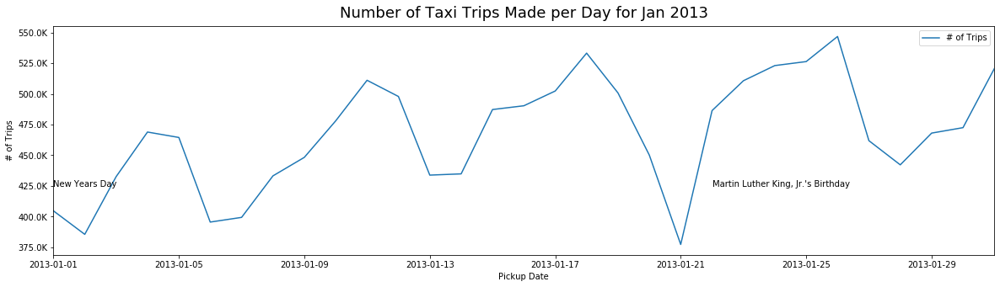

In [45]:
#plot
fig, ax = plt.subplots(figsize=(20,5))
ax.set_title('Number of Taxi Trips Made per Day for ' + dt, title_font)

visDataTrips.plot(kind='line', x="Pickup Date", y="# of Trips", ax=ax)
ax.set( xlabel='Pickup Date', ylabel='# of Trips')

formatter = FuncFormatter(number)
ax.yaxis.set_major_formatter(formatter)

if dt == "Jan 2013":
    ax.text('2013-01-22', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "Martin Luther King, Jr.'s Birthday")
    ax.text('2013-01-01', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "New Years Day")

plt.show()

In [46]:
ax.get_ylim()[1] /10

55529.255000000005

## Number of Passengers

In [47]:
# Calc the number of passengers moved per day
visDataPassenger = tripDataFare.groupby(['pickup_date'], as_index=False)['passenger_count'].agg('sum')
# sort the dates
visDataPassenger = visDataPassenger.sort_values(by=['pickup_date'])
visDataPassenger.columns = ['Pickup Date', '# of Passengers']
visDataPassenger.head()

,Pickup Date,# of Passengers
0,2013-01-01,742771
1,2013-01-02,660488
2,2013-01-03,733922
3,2013-01-04,801180
4,2013-01-05,827591


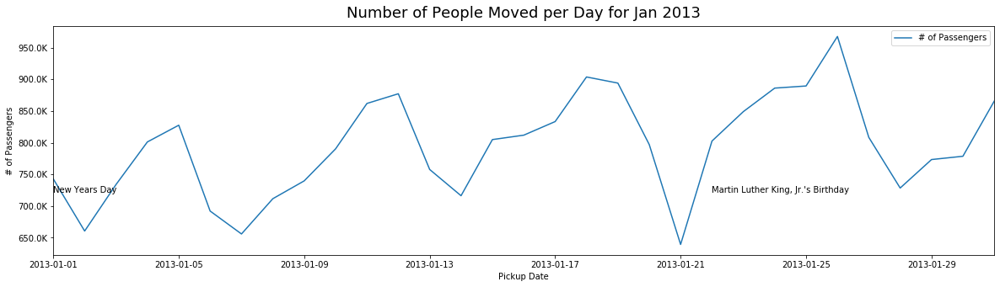

In [48]:
#plot
fig, ax = plt.subplots(figsize=(20,5))
ax.set_title('Number of People Moved per Day for ' + dt, title_font)

visDataPassenger.plot(kind='line', x="Pickup Date", y="# of Passengers", ax=ax)
ax.set( xlabel='Pickup Date', ylabel='# of Passengers')

formatter = FuncFormatter(number)
ax.yaxis.set_major_formatter(formatter)

if dt == "Jan 2013":
    ax.text('2013-01-22', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "Martin Luther King, Jr.'s Birthday")
    ax.text('2013-01-01', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "New Years Day")

plt.show()

## Revenue

### Fare Revenue Only

In [49]:
# Calc the number of passengers moved per day
visDataFareRevenue = tripDataFare.groupby(['pickup_date'], as_index=False)['fare_amount'].agg('sum')
# sort the dates
visDataFareRevenue = visDataFareRevenue.sort_values(by=['pickup_date'])
visDataFareRevenue.columns = ['Pickup Date', 'Fare Revenue']
visDataFareRevenue.head()

,Pickup Date,Fare Revenue
0,2013-01-01,5174589.49
1,2013-01-02,4605784.16
2,2013-01-03,4978836.57
3,2013-01-04,5273734.56
4,2013-01-05,5235966.73


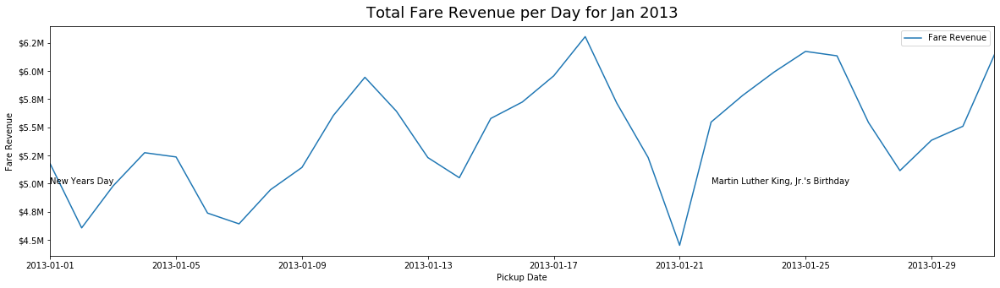

In [50]:
fig, ax = plt.subplots(figsize=(20,5))
ax.set_title('Total Fare Revenue per Day for ' + dt, title_font)

visDataFareRevenue.plot(kind='line', x="Pickup Date", y="Fare Revenue", ax=ax)
ax.set( xlabel='Pickup Date', ylabel='Fare Revenue')

formatter = FuncFormatter(currency)
ax.yaxis.set_major_formatter(formatter)

if dt == "Jan 2013":
    ax.text('2013-01-22', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "Martin Luther King, Jr.'s Birthday")
    ax.text('2013-01-01', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "New Years Day")

plt.show()

### Total Revenue

In [51]:
# Calc the number of passengers moved per day
visDataRevenue = tripDataFare.groupby(['pickup_date'], as_index=False)['total_amount'].agg('sum')
# sort the dates
visDataRevenue = visDataRevenue.sort_values(by=['pickup_date'])
visDataRevenue.columns = ['Pickup Date', 'Total Revenue']
visDataRevenue.head()

,Pickup Date,Total Revenue
0,2013-01-01,6.009094e+06
1,2013-01-02,5.473108e+06
2,2013-01-03,5.928965e+06
3,2013-01-04,6.296397e+06
4,2013-01-05,6.140703e+06


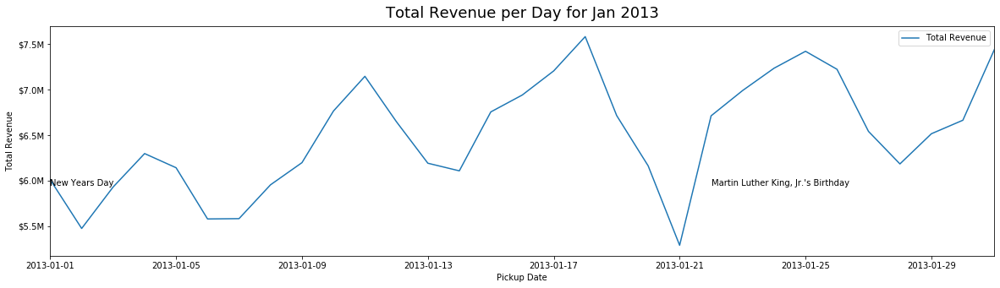

In [52]:
fig, ax = plt.subplots(figsize=(20,5))
ax.set_title('Total Revenue per Day for ' + dt, title_font)

visDataRevenue.plot(kind='line', x="Pickup Date", y="Total Revenue", ax=ax)
ax.set( xlabel='Pickup Date', ylabel='Total Revenue')

formatter = FuncFormatter(currency)
ax.yaxis.set_major_formatter(formatter)

if dt == "Jan 2013":
    ax.text('2013-01-22', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "Martin Luther King, Jr.'s Birthday")
    ax.text('2013-01-01', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "New Years Day")

plt.show()

# Combined

## Fare and Total Fare Revenue

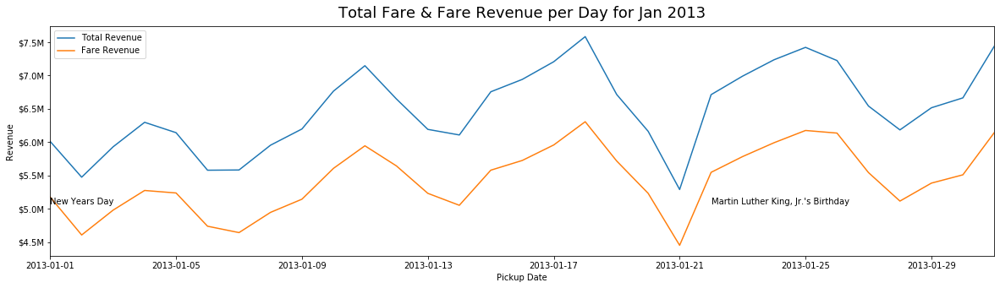

In [53]:
fig, ax = plt.subplots(figsize=(20,5))
ax.set_title('Total Fare & Fare Revenue per Day for ' + dt, title_font)

visDataRevenue.plot(kind='line', x="Pickup Date", y="Total Revenue", ax=ax)
visDataFareRevenue.plot(kind='line', x="Pickup Date", y="Fare Revenue", ax=ax)
ax.set( xlabel='Pickup Date', ylabel='Revenue')

formatter = FuncFormatter(currency)
ax.yaxis.set_major_formatter(formatter)

if dt == "Jan 2013":
    ax.text('2013-01-22', ax.get_ylim()[0] + ax.get_ylim()[1] /10 , "Martin Luther King, Jr.'s Birthday")
    ax.text('2013-01-01', ax.get_ylim()[0] + ax.get_ylim()[1] /10 , "New Years Day")

plt.show()

## Trips and Passengers

## Trips and Passengers

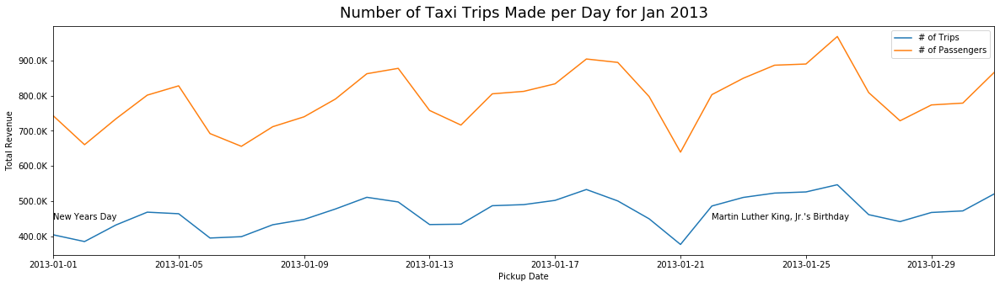

In [54]:
#plot
fig, ax = plt.subplots(figsize=(20,5))
ax.set_title('Number of Taxi Trips Made per Day for ' + dt, title_font)

visDataTrips.plot(kind='line', x="Pickup Date", y="# of Trips", ax=ax)
visDataPassenger.plot(kind='line', x="Pickup Date", y="# of Passengers", ax=ax)
ax.set( xlabel='Pickup Date', ylabel='Total Revenue')

formatter = FuncFormatter(number)
ax.yaxis.set_major_formatter(formatter)

if dt == "Jan 2013":
    ax.text('2013-01-22', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "Martin Luther King, Jr.'s Birthday")
    ax.text('2013-01-01', ax.get_ylim()[0] + ax.get_ylim()[1] /10, "New Years Day")

plt.show()

# Scatter

## # of Trips & # of Passengers

In [55]:
visDataTripsPassengers = pd.merge(visDataTrips, visDataPassenger, how='left', left_on = ['Pickup Date'], right_on = ['Pickup Date'])
visDataTripsPassengers.head()


,Pickup Date,# of Trips,# of Passengers
0,2013-01-01,404683,742771
1,2013-01-02,385499,660488
2,2013-01-03,432544,733922
3,2013-01-04,468914,801180
4,2013-01-05,464489,827591


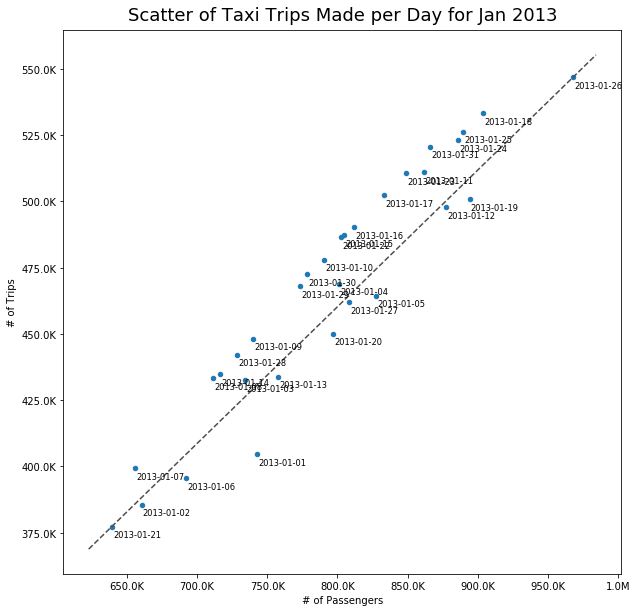

In [56]:
#plot
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title('Scatter of Taxi Trips Made per Day for ' + dt, title_font)

visDataTripsPassengers.plot(kind='scatter', x='# of Passengers', y='# of Trips',  s=20, ax=ax)

for line in range(0,visDataTripsPassengers.shape[0]):
    ax.text(visDataTripsPassengers['# of Passengers'][line]+900, visDataTripsPassengers['# of Trips'][line]-4000, \
             visDataTripsPassengers['Pickup Date'][line], horizontalalignment='left', size='small', color='black')

formatter = FuncFormatter(number)
ax.yaxis.set_major_formatter(formatter)
ax.xaxis.set_major_formatter(formatter)
ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c=".3")

plt.show()

## Total Fare Revenue & # of Trips

In [57]:
visDataTripsPassengersRevenue = pd.merge(visDataTripsPassengers, visDataRevenue, how='left', left_on = ['Pickup Date'], right_on = ['Pickup Date'])
visDataTripsPassengersRevenue.head()

,Pickup Date,# of Trips,# of Passengers,Total Revenue
0,2013-01-01,404683,742771,6.009094e+06
1,2013-01-02,385499,660488,5.473108e+06
2,2013-01-03,432544,733922,5.928965e+06
3,2013-01-04,468914,801180,6.296397e+06
4,2013-01-05,464489,827591,6.140703e+06


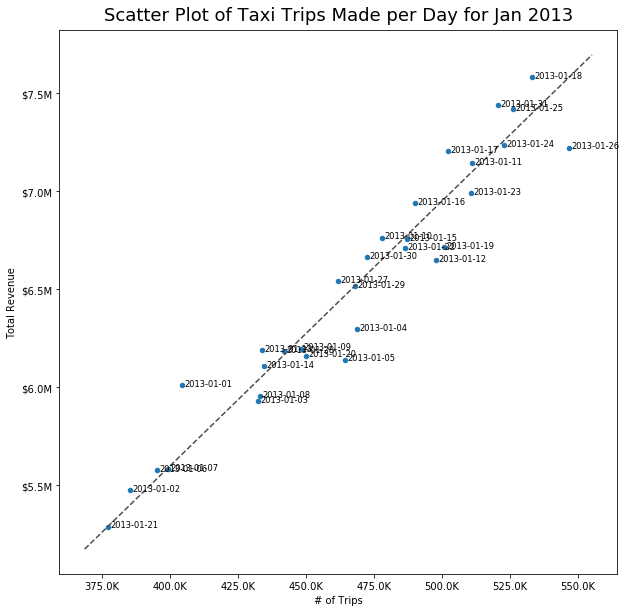

In [58]:
#plot
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title('Scatter Plot of Taxi Trips Made per Day for ' + dt, title_font)

visDataTripsPassengersRevenue.plot(kind='scatter', x='# of Trips', y='Total Revenue', s=20 , ax=ax)

for line in range(0,visDataTripsPassengers.shape[0]):
    ax.text(visDataTripsPassengersRevenue['# of Trips'][line]+900, visDataTripsPassengersRevenue['Total Revenue'][line]-4000, \
             visDataTripsPassengersRevenue['Pickup Date'][line], horizontalalignment='left', size='small', color='black')

formatter = FuncFormatter(currency)
ax.yaxis.set_major_formatter(formatter)
formatter = FuncFormatter(number)
ax.xaxis.set_major_formatter(formatter)
ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c=".3")

plt.show()

## Total Fare Revenue & Fare Revenue

In [59]:
visDataTripsPassengersRevenueFareRevenue = pd.merge(visDataTripsPassengersRevenue, visDataFareRevenue, how='left', left_on = ['Pickup Date'], right_on = ['Pickup Date'])
visDataTripsPassengersRevenueFareRevenue.head()

,Pickup Date,# of Trips,# of Passengers,Total Revenue,Fare Revenue
0,2013-01-01,404683,742771,6.009094e+06,5174589.49
1,2013-01-02,385499,660488,5.473108e+06,4605784.16
2,2013-01-03,432544,733922,5.928965e+06,4978836.57
3,2013-01-04,468914,801180,6.296397e+06,5273734.56
4,2013-01-05,464489,827591,6.140703e+06,5235966.73


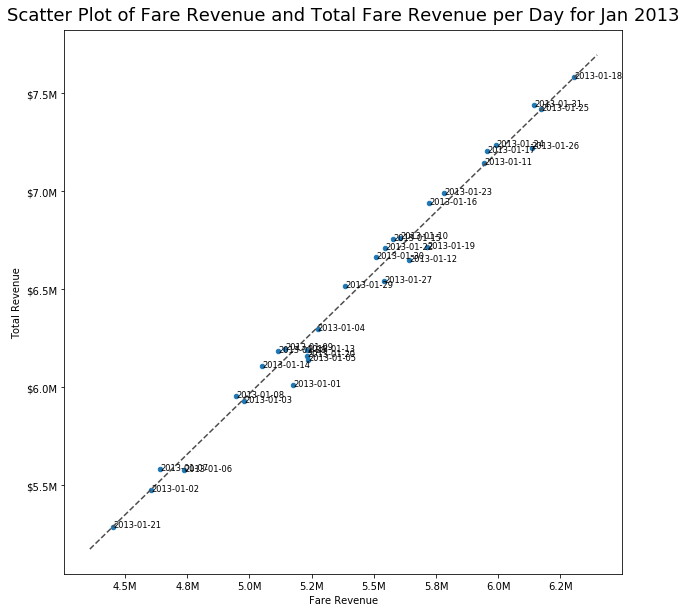

In [60]:
#plot
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title('Scatter Plot of Fare Revenue and Total Fare Revenue per Day for ' + dt, title_font)

visDataTripsPassengersRevenueFareRevenue.plot(kind='scatter', x='Fare Revenue', y='Total Revenue', s=20 , ax=ax)

for line in range(0,visDataTripsPassengers.shape[0]):
    ax.text(visDataTripsPassengersRevenueFareRevenue['Fare Revenue'][line]+900, visDataTripsPassengersRevenueFareRevenue['Total Revenue'][line]-4000, \
             visDataTripsPassengersRevenueFareRevenue['Pickup Date'][line], horizontalalignment='left', size='small', color='black')

formatter = FuncFormatter(currency)
ax.yaxis.set_major_formatter(formatter)
formatter = FuncFormatter(number)
ax.xaxis.set_major_formatter(formatter)
ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c=".3")

plt.show()

# Question 2


# Visualising the busiest hours

source: https://chih-ling-hsu.github.io/2018/05/14/NYC

In [61]:
def plt_clock(ax, radii, title, color):
    N = 24
    bottom = 2

    # create theta for 24 hours
    theta = np.linspace(0.0, 2 * np.pi, N, endpoint=False)


    # width of each bin on the plot
    width = (2*np.pi) / N
    
    bars = ax.bar(theta, radii, width=width, bottom=bottom, color=color, edgecolor="#999999")

    # set the lable go clockwise and start from the top
    ax.set_theta_zero_location("N")
    # clockwise
    ax.set_theta_direction(-1)

    # set the label
    ax.set_xticks(theta)
    ticks = ["{}:00".format(x) for x in range(24)]
    ax.set_xticklabels(ticks)
    ax.set_title(title)

## Getting the data into the correct format

In [62]:
def tripVis (tripLengthBoundary = 10):
    visData = tripDataFare[['pickup_hour', 'dropoff_hour']][tripDataFare['trip_distance'] < tripLengthBoundary] 
    visData['count'] = 1
    df_q3_short = visData.groupby(['pickup_hour', 'dropoff_hour'],as_index=False).count()
    df_q3_short.columns = ['PUtime', 'DOtime', 'count']
    #df_q3_short.head()
    visData = tripDataFare[['pickup_hour', 'dropoff_hour']][tripDataFare['trip_distance'] >= tripLengthBoundary] 
    visData['count'] = 1
    df_q3_long = visData.groupby(['pickup_hour', 'dropoff_hour'],as_index=False).count()
    df_q3_long.columns = ['PUtime', 'DOtime', 'count']
    #df_q3_long.head()
    df_q3 = df_q3_short.merge(df_q3_long, how='left', on=["PUtime", "DOtime"], suffixes=["_short", "_long"]) \
                        .rename(columns={"count_short":"short trips", "count_long":"long trips", \
                                        "PUtime":"pickup time", "DOtime":"dropoff time"})
    #create pickup time dataframe
    df_q3_PU = df_q3.groupby(["pickup time"], as_index=False) \
            .agg({'short trips': 'sum', 'long trips':'sum'}) \
            .sort_values(by="pickup time")
    #df_q3_PU.head()
    #create dropoff time dataframe
    df_q3_DO = df_q3.groupby(["dropoff time"], as_index=False) \
            .agg({'short trips': 'sum', 'long trips':'sum'}) \
            .sort_values(by="dropoff time")
    #df_q3_DO.head()
    # diff_short_long_trip_on_time()
    fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(18,18))

    ax = plt.subplot(2,2,1, polar=True)
    # make the histogram that bined on 24 hour
    radii = np.array(df_q3_PU['short trips'].tolist(), dtype="int64")
    title = "Pickup Time for Short Trips"
    plt_clock(ax, radii, title, "#dc143c")

    ax = plt.subplot(2,2,2, polar=True)
    # make the histogram that bined on 24 hour
    radii = np.array(df_q3_PU['long trips'].tolist(), dtype="int64")
    title = "Pickup Time for Long Trips"
    plt_clock(ax, radii, title, "#56B4E9")

    ax = plt.subplot(2,2,3, polar=True)
    # make the histogram that bined on 24 hour
    radii = np.array(df_q3_DO['short trips'].tolist(), dtype="int64")
    title = "Dropoff Time for Short Trips"
    plt_clock(ax, radii, title, "#dc143c")

    ax = plt.subplot(2,2,4, polar=True)
    # make the histogram that bined on 24 hour
    radii = np.array(df_q3_DO['long trips'].tolist(), dtype="int64")
    title = "Dropoff Time for Long Trips"
    plt_clock(ax, radii, title, "#56B4E9")

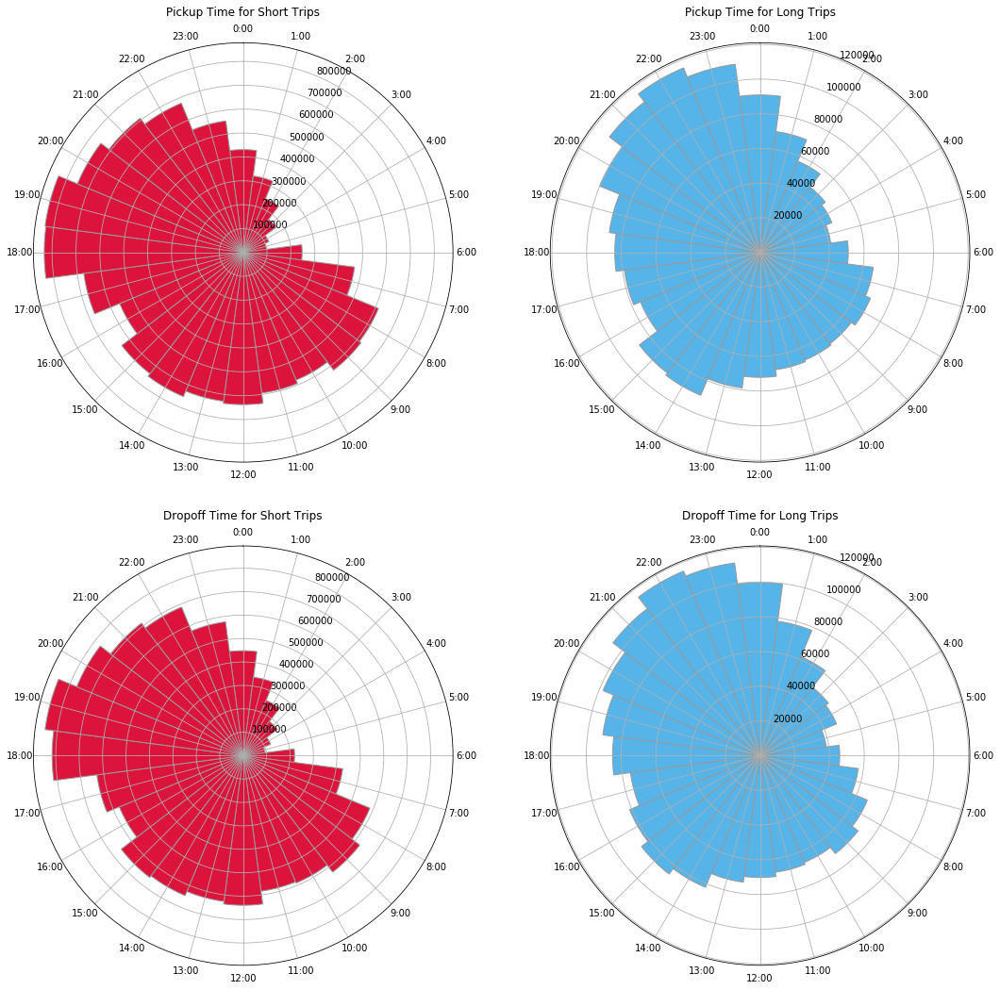

In [63]:
tripVis(5)


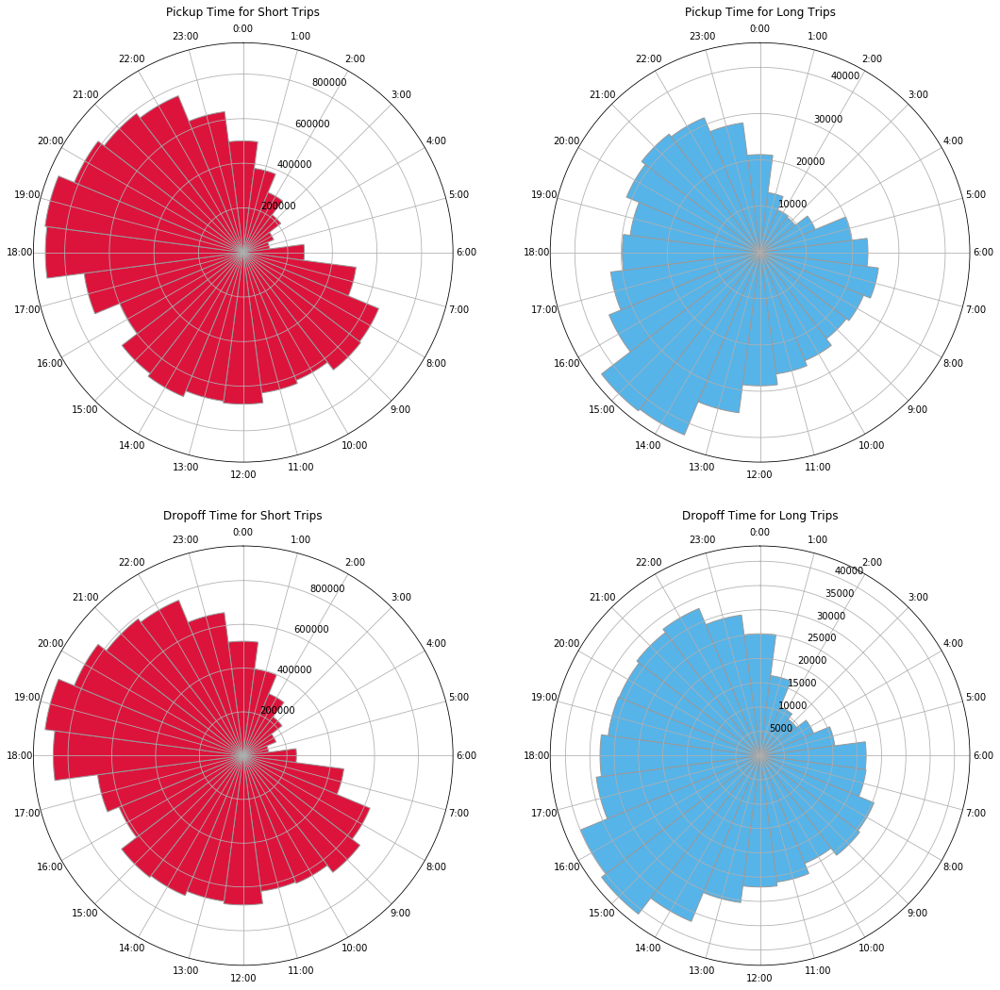

In [64]:
tripVis(10)

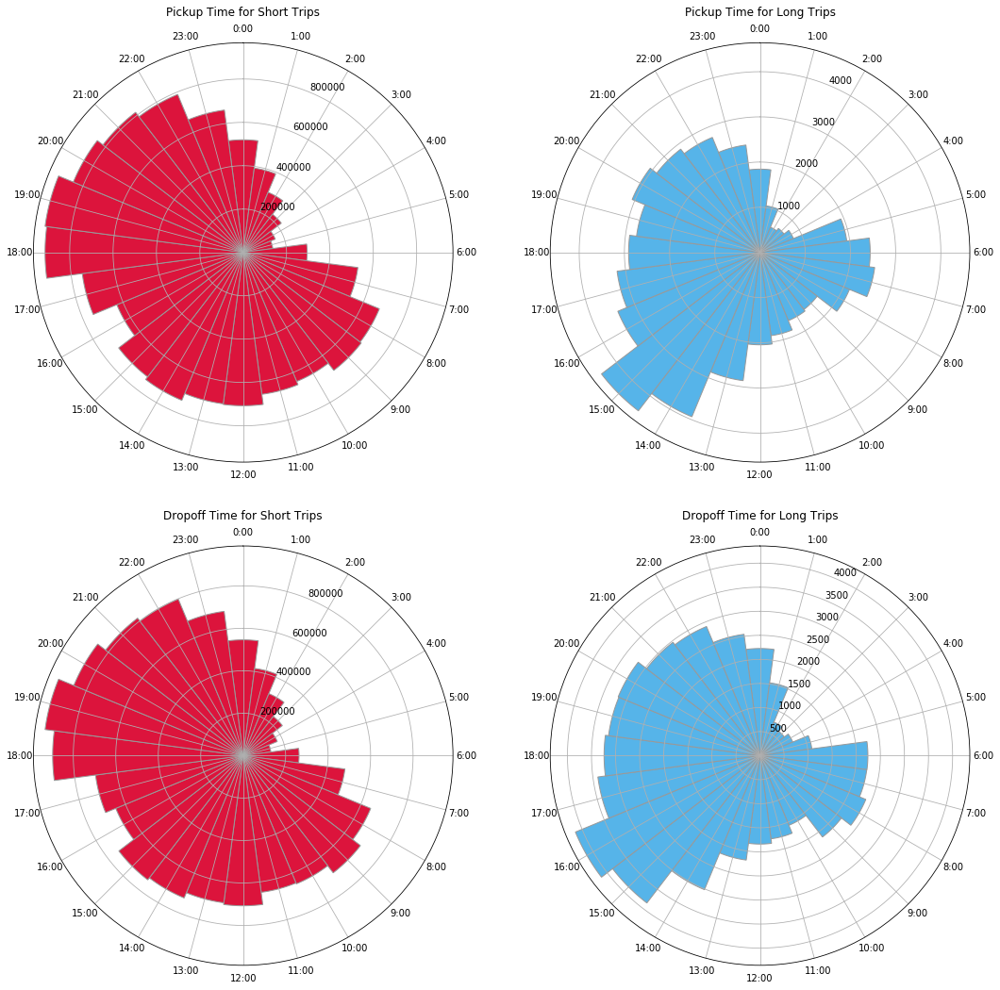

In [65]:
tripVis(20)

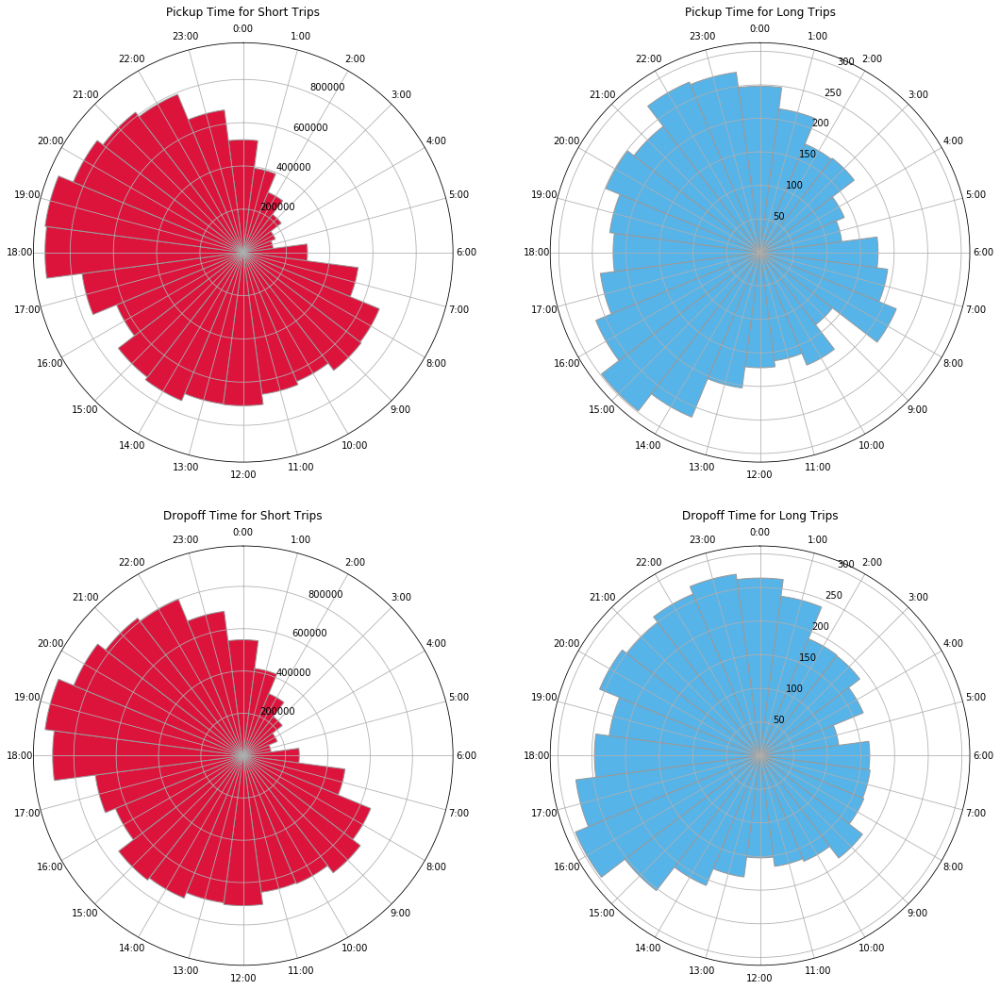

In [66]:
tripVis(30)

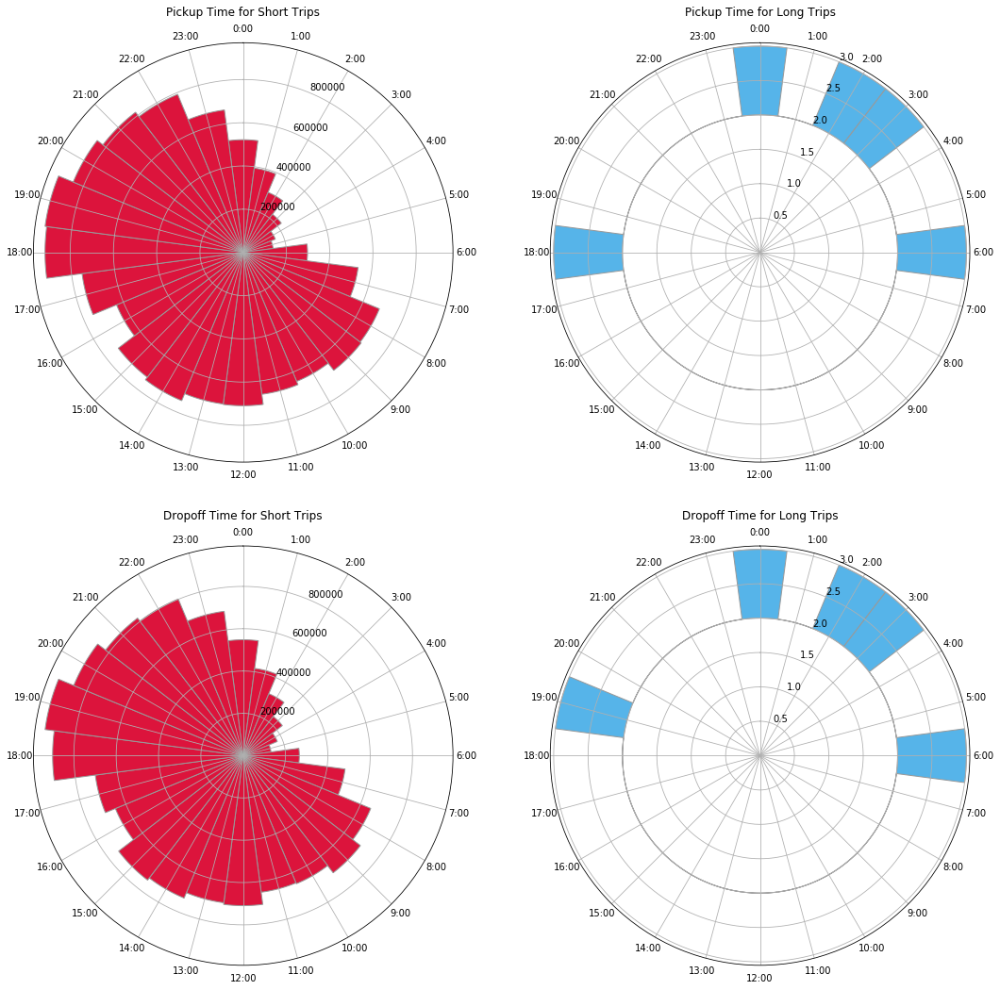

In [67]:
tripVis(100)

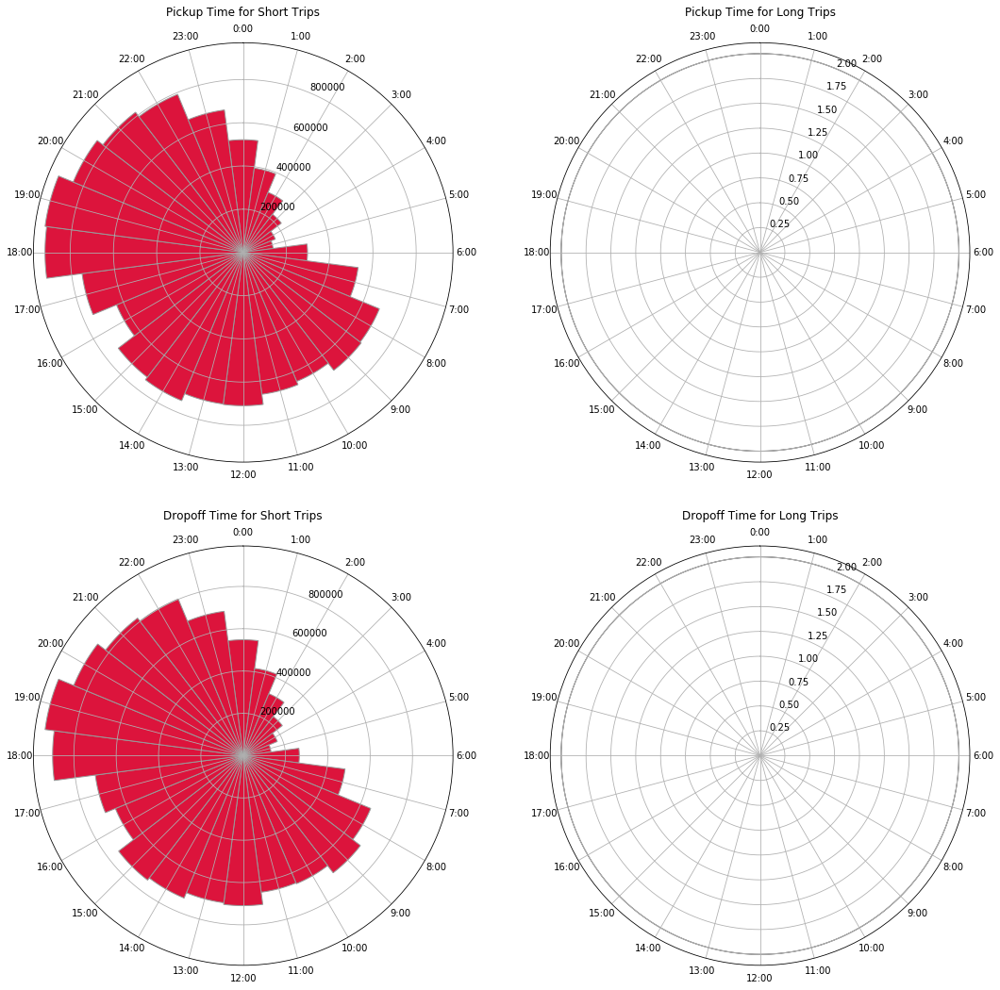

In [68]:
tripVis(200)

In [69]:
del  tripVis

gc.collect()

40558

# Question 3

How are Passengers per trip, payment type, fare and tip amounts distributed?


## Reporting axis ordering section

In [70]:
def retOrderMapping(field):
    if field == 'tripLength':
            return tripLengthOrderMapping
    elif field == 'tripDuration':
        return tripDurationMapping
    elif field == 'pickup_weekdayWeekend':
        return weekdayWeekendMapping
    elif field == 'pickup_dayName':
        return dayNameMapping
    elif field == 'vendor_id':
        return vendor_idOrderMapping
    elif field == 'payment_type':
        return payment_typeOrderMapping  
    elif field == 'Taxi Use':
        return taxiUseOrderMapping  
    elif field == 'pickup_timeOfDay':
        return pickup_timeOfDayOrderMapping

In [71]:
tripLengthOrder = ['up to 1 mile', '1 to 5 miles', '6 to 10 miles', '10 to 20 miles', '20 + miles', 'Error']
# this creates some value key pairs in the correct order
tripLengthOrderMapping = {trip: i for i, trip in enumerate(tripLengthOrder)}
del tripLengthOrder

In [72]:
payment_typeOrder = ['CSH', 'CRD', 'DIS', 'NOC',  'UNK']
# this creates some value key pairs in the correct order
payment_typeOrderMapping = {trip: i for i, trip in enumerate(payment_typeOrder)}
del payment_typeOrder

In [73]:
vendor_idOrder = ['CMT', 'VTS']
# this creates some value key pairs in the correct order
vendor_idOrderMapping = {trip: i for i, trip in enumerate(vendor_idOrder)}
del vendor_idOrder

In [74]:
taxiUseOrder = ['Single Use', 'Low', 'Medium', 'High', 'Extreme', 'Error']
# this creates some value key pairs in the correct order
taxiUseOrderMapping = {trip: i for i, trip in enumerate(taxiUseOrder)}
del taxiUseOrder

In [75]:
pickup_timeOfDayOrder = ['Morning Rush Hour', 'Late morning', 'Early afternoon', 'Evening Rush Hour', 'Evening', 'Night', 'Error' ]
# this creates some value key pairs in the correct order
pickup_timeOfDayOrderMapping = {trip: i for i, trip in enumerate(pickup_timeOfDayOrder)}
del pickup_timeOfDayOrder

In [76]:
weekdayWeekend = ['Weekday', 'Weekend']
# this creates some value key pairs in the correct order
weekdayWeekendMapping = {trip: i for i, trip in enumerate(weekdayWeekend)}
del weekdayWeekend

In [77]:
tripDuration = ['up to 5 minutes', '5 to 10 minutes', '10 to 15 minutes', '15 to 20 minutes', '20 + minutes', 'Error']
# this creates some value key pairs in the correct order
tripDurationMapping = {trip: i for i, trip in enumerate(tripDuration)}
del tripDuration

In [78]:
dayName = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# this creates some value key pairs in the correct order
dayNameMapping = {trip: i for i, trip in enumerate(dayName)}
del dayName

In [79]:
# free memory
gc.collect()

60

In [80]:
# create a df to use for visualising
visDataQ3 = tripDataFare[['pickup_date','passenger_count', 'trip_distance', 'rate_code',
       'store_and_fwd_flag', 'payment_type', 'fare_amount', 'surcharge', 'mta_tax', 'tip_amount',
       'tolls_amount', 'total_amount', 'pickup_dayName', 'pickup_weekdayWeekend', 'tripLength',
       'tripDuration']]
visDataQ3.head()

,pickup_date,passenger_count,trip_distance,rate_code,store_and_fwd_flag,payment_type,fare_amount,surcharge,mta_tax,tip_amount,tolls_amount,total_amount,pickup_dayName,pickup_weekdayWeekend,tripLength,tripDuration
0,2013-01-01,4,1.0,1,N,CSH,6.5,0.0,0.5,0.0,0.0,7.0,Tuesday,Weekday,up to 1 mile,5 to 10 minutes
1,2013-01-06,1,1.5,1,N,CSH,6.0,0.5,0.5,0.0,0.0,7.0,Sunday,Weekend,1 to 5 miles,up to 5 minutes
2,2013-01-05,1,1.1,1,N,CSH,5.5,1.0,0.5,0.0,0.0,7.0,Saturday,Weekend,1 to 5 miles,up to 5 minutes
3,2013-01-07,2,0.7,1,N,CSH,5.0,0.5,0.5,0.0,0.0,6.0,Monday,Weekday,up to 1 mile,up to 5 minutes
4,2013-01-07,1,2.1,1,N,CSH,9.5,0.5,0.5,0.0,0.0,10.5,Monday,Weekday,1 to 5 miles,5 to 10 minutes


In [102]:
#clean up
del visDataQ3, visQ3

gc.collect()

15726

# Drivers

In [103]:
def taxiUse(i):
    # look at the number of taxis they use and categorise on that
    if i <= 0:  # catches 0 and neg numbers as errors
        result = "Error"
    elif i > 0 and i <= 1:
        result = "Single Use"
    elif i > 1 and i <= 5:
        result = "Low"
    elif i > 6 and i <= 10:
        result = "Medium"
    elif i > 10 and i <= 20:
        result = "High"
    else:
        result = "Extreme"
    return result

In [104]:
driverVehicle = tripDataFare[['medallion', 'hack_license', 'fare_amount', 'tip_amount', 'total_amount', 'trip_time_in_secs']]
driverVehicle['count'] = 1

/opt/conda/envs/working/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [105]:
#driverVehicle.groupby(['medallion', 'hack_license']).agg('sum')

In [106]:
# filter out some rows for testing code
filter = ['00567B1CBFD51DDFAC73359B09238922', '0002555BBE359440D6CEB34B699D3932', '00B7691D86D96AEBD21DD9E138F90840']
#driverVehicle[driverVehicle['hack_license'].isin(filter)].groupby(['hack_license', 'medallion']).agg('count')

In [107]:
# filter out some rows for testing code
#driverVehicle[['hack_license', 'medallion']][driverVehicle['hack_license'].isin(filter)].groupby(['hack_license'])['medallion'].nunique()

In [108]:
#driverVehicle[driverVehicle['hack_license'].isin(filter)].groupby(['hack_license', 'medallion'], as_index=False).agg('sum')

In [109]:
driverTaxiJourneys = driverVehicle.groupby(['hack_license', 'medallion'], as_index=False).agg('sum')
driverTaxiJourneys.head()

,hack_license,medallion,fare_amount,tip_amount,total_amount,trip_time_in_secs,count
0,0002555BBE359440D6CEB34B699D3932,BE530E79CB7E459DEF5BBDF2F319EDC1,6381.5,841.29,7956.49,342782,505
1,0008B3E338CE8C3377E071A4D80D3694,8FA6FBF2D595A1080BCCE03FC2C213F7,6565.5,728.84,7983.54,363300,543
2,000A4EBF1CEB9C6BD9978D4362493C6E,515D614B20D2BF3BEF939169D925B95C,4586.5,593.95,5680.25,270063,358
3,000B8D660A329BBDBF888500E4BD8B98,5BD01248C41330B7CBE188BCB7808710,198.0,27.69,251.19,12807,22
4,000B8D660A329BBDBF888500E4BD8B98,DC1BD2B0B0BE3A6513F54B8138FD9F6A,5929.0,580.59,7057.49,338524,496


In [110]:
driverTaxiJourneys.columns = ['Driver', 'Taxi', 'Fare Amount', 'Tip Amount', 'Total Amount', 'Trip Time (sec)', 'Trip Count',]

In [111]:
# calculate the number of taxis jounreys used by a driver in the data (in this case a month)
# output of value counts is a series so need to convert to frame and then reset the index to bring the driver into a column
driverInfo = driverTaxiJourneys['Driver'].value_counts().to_frame().reset_index()
driverInfo.columns = ['Driver', '# of Taxis']
driverInfo.head()

,Driver,# of Taxis
0,00B7691D86D96AEBD21DD9E138F90840,333
1,C1059E614E05082428C20540004D03CE,161
2,AF21D0C97DB2E27E13572CBF59EB343D,155
3,C667D53ACD899A97A85DE0C201BA99BE,144
4,B59C67BF196A4758191E42F76670CEBA,137


In [112]:
# add in the total number of trips the driver has made this month
# this is done inline
driverInfo = pd.merge(driverInfo, \
                      driverTaxiJourneys.groupby(['Driver'], as_index=False).agg(["sum", "mean"]), \
                      how='left', \
                      left_on = ['Driver'], \
                      right_on = ['Driver'] )
driverInfo.head()

/opt/conda/envs/working/lib/python3.7/site-packages/pandas/core/reshape/merge.py:522: UserWarning: merging between different levels can give an unintended result (1 levels on the left, 2 on the right)
  warnings.warn(msg, UserWarning)


,Driver,# of Taxis,"(Fare Amount, sum)","(Fare Amount, mean)","(Tip Amount, sum)","(Tip Amount, mean)","(Total Amount, sum)","(Total Amount, mean)","(Trip Time (sec), sum)","(Trip Time (sec), mean)","(Trip Count, sum)","(Trip Count, mean)"
0,00B7691D86D96AEBD21DD9E138F90840,333,4652.53,13.971562,239.37,0.718829,5503.70,16.527628,207540,623.243243,814,2.444444
1,C1059E614E05082428C20540004D03CE,161,1072.90,6.663975,0.00,0.000000,1208.40,7.505590,31343,194.677019,262,1.627329
2,AF21D0C97DB2E27E13572CBF59EB343D,155,665.50,4.293548,0.00,0.000000,789.40,5.092903,14178,91.470968,215,1.387097
3,C667D53ACD899A97A85DE0C201BA99BE,144,729.00,5.062500,0.00,0.000000,846.15,5.876042,20501,142.368056,195,1.354167
4,B59C67BF196A4758191E42F76670CEBA,137,1095.70,7.997810,0.00,0.000000,1238.70,9.041606,16304,119.007299,197,1.437956


In [113]:
driverInfo.columns = ['Driver', '# of Taxis', 'Fare Amount (sum)', 'Fare Amount (mean)', 'Tip Amount (sum)', 'Tip Amount (mean)', 'Total Amount (sum)', 'Total Amount (mean)', 'Trip Time (sec) (sum)', 'Trip Time (sec) (mean)', 'Trip Count (sum)','Trip Count (mean)']

In [114]:
driverInfo['Trips Per Taxi'] = driverInfo['Trip Count (sum)'] / driverInfo['# of Taxis']
driverInfo['Fare Per Trip'] = driverInfo['Fare Amount (sum)'] / driverInfo['Trip Count (sum)']
driverInfo['Tip Per Trip'] = driverInfo['Tip Amount (sum)'] / driverInfo['Trip Count (sum)']
driverInfo['Amount Per Trip'] = driverInfo['Total Amount (sum)'] / driverInfo['Trip Count (sum)']
driverInfo['Journey Time (sec) Per Trip'] = driverInfo['Trip Time (sec) (sum)'] / driverInfo['Trip Count (sum)']
driverInfo['Journey Time (mins) Per Trip'] = (driverInfo['Trip Time (sec) (sum)']/60) / driverInfo['Trip Count (sum)']
driverInfo['Trip Time (mins) (sum)'] = (driverInfo['Trip Time (sec) (sum)']/60)
driverInfo['Trip Time (hrs) (sum)'] = (driverInfo['Trip Time (sec) (sum)']/3600)
driverInfo['Trip Time (mins) (mean)'] = (driverInfo['Trip Time (sec) (mean)']/60)
driverInfo.head()

,Driver,# of Taxis,Fare Amount (sum),Fare Amount (mean),Tip Amount (sum),Tip Amount (mean),Total Amount (sum),Total Amount (mean),Trip Time (sec) (sum),Trip Time (sec) (mean),Trip Count (sum),Trip Count (mean),Trips Per Taxi,Fare Per Trip,Tip Per Trip,Amount Per Trip,Journey Time (sec) Per Trip,Journey Time (mins) Per Trip,Trip Time (mins) (sum),Trip Time (hrs) (sum),Trip Time (mins) (mean)
0,00B7691D86D96AEBD21DD9E138F90840,333,4652.53,13.971562,239.37,0.718829,5503.70,16.527628,207540,623.243243,814,2.444444,2.444444,5.715639,0.294066,6.761302,254.963145,4.249386,3459.000000,57.650000,10.387387
1,C1059E614E05082428C20540004D03CE,161,1072.90,6.663975,0.00,0.000000,1208.40,7.505590,31343,194.677019,262,1.627329,1.627329,4.095038,0.000000,4.612214,119.629771,1.993830,522.383333,8.706389,3.244617
2,AF21D0C97DB2E27E13572CBF59EB343D,155,665.50,4.293548,0.00,0.000000,789.40,5.092903,14178,91.470968,215,1.387097,1.387097,3.095349,0.000000,3.671628,65.944186,1.099070,236.300000,3.938333,1.524516
3,C667D53ACD899A97A85DE0C201BA99BE,144,729.00,5.062500,0.00,0.000000,846.15,5.876042,20501,142.368056,195,1.354167,1.354167,3.738462,0.000000,4.339231,105.133333,1.752222,341.683333,5.694722,2.372801
4,B59C67BF196A4758191E42F76670CEBA,137,1095.70,7.997810,0.00,0.000000,1238.70,9.041606,16304,119.007299,197,1.437956,1.437956,5.561929,0.000000,6.287817,82.761421,1.379357,271.733333,4.528889,1.983455


Code to view the counts 
from collections import Counter
hist = Counter(driverInfo['# of Taxis'])


In [115]:
# # look at the number of taxis they use and categorise on that
driverInfo['Taxi Use'] = driverInfo["# of Taxis"].map(lambda x: taxiUse(x))

### Trips per taxi

In [128]:
tripDataFare.columns

Index(['medallion', 'hack_license', 'vendor_id', 'rate_code',
       'store_and_fwd_flag', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'trip_time_in_secs', 'trip_distance',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'pickup_datetime_dt', 'dropoff_datetime_dt',
       'payment_type', 'fare_amount', 'surcharge', 'mta_tax', 'tip_amount',
       'tolls_amount', 'total_amount', 'trip_time_in_min', 'pickup_day',
       'pickup_month', 'pickup_year', 'pickup_date', 'pickup_weekday',
       'pickup_isoweekday', 'pickup_hour', 'pickup_minute', 'pickup_time',
       'pickup_dayName', 'pickup_weekdayWeekend', 'pickup_timeOfDay',
       'dropoff_day', 'dropoff_month', 'dropoff_year', 'dropoff_date',
       'dropoff_weekday', 'dropoff_isoweekday', 'dropoff_hour',
       'dropoff_minute', 'dropoff_time', 'dropoff_dayName',
       'dropoff_weekdayWeekend', 'dropoff_timeOfDay', 'tripLength',
       'tripDuration'],
      dtype='ob

In [129]:
tripDataFare = pd.merge(tripDataFare, driverInfo[['Driver', 'Taxi Use']], \
                        how='left', left_on = ['hack_license'], right_on = ['Driver'])
# dont need the extra column as it is the same
tripDataFare.drop('Driver', axis=1)
tripDataFare.head()

,medallion,hack_license,vendor_id,rate_code,store_and_fwd_flag,pickup_datetime,dropoff_datetime,passenger_count,trip_time_in_secs,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,pickup_datetime_dt,dropoff_datetime_dt,payment_type,fare_amount,surcharge,mta_tax,tip_amount,tolls_amount,total_amount,trip_time_in_min,pickup_day,pickup_month,pickup_year,pickup_date,pickup_weekday,pickup_isoweekday,pickup_hour,pickup_minute,pickup_time,pickup_dayName,pickup_weekdayWeekend,pickup_timeOfDay,dropoff_day,dropoff_month,dropoff_year,dropoff_date,dropoff_weekday,dropoff_isoweekday,dropoff_hour,dropoff_minute,dropoff_time,dropoff_dayName,dropoff_weekdayWeekend,dropoff_timeOfDay,tripLength,tripDuration,Driver,Taxi Use
0,89D227B655E5C82AECF13C3F540D4CF4,BA96DE419E711691B9445D6A6307C170,CMT,1,N,2013-01-01 15:11:48,2013-01-01 15:18:10,4,382,1.0,-73.978165,40.757977,-73.989838,40.751171,2013-01-01 15:11:48,2013-01-01 15:18:10,CSH,6.5,0.0,0.5,0.0,0.0,7.0,6.366667,1,1,2013,2013-01-01,1,2,15,11,15:11:48,Tuesday,Weekday,Early afternoon,1,1,2013,2013-01-01,1,2,15,18,15:18:10,Tuesday,Weekday,Early afternoon,up to 1 mile,5 to 10 minutes,BA96DE419E711691B9445D6A6307C170,Single Use
1,0BD7C8F5BA12B88E0B67BED28BEA73D8,9FD8F69F0804BDB5549F40E9DA1BE472,CMT,1,N,2013-01-06 00:18:35,2013-01-06 00:22:54,1,259,1.5,-74.006683,40.731781,-73.994499,40.750660,2013-01-06 00:18:35,2013-01-06 00:22:54,CSH,6.0,0.5,0.5,0.0,0.0,7.0,4.316667,6,1,2013,2013-01-06,6,7,0,18,00:18:35,Sunday,Weekend,Night,6,1,2013,2013-01-06,6,7,0,22,00:22:54,Sunday,Weekend,Night,1 to 5 miles,up to 5 minutes,9FD8F69F0804BDB5549F40E9DA1BE472,Single Use
2,0BD7C8F5BA12B88E0B67BED28BEA73D8,9FD8F69F0804BDB5549F40E9DA1BE472,CMT,1,N,2013-01-05 18:49:41,2013-01-05 18:54:23,1,282,1.1,-74.004707,40.737770,-74.009834,40.726002,2013-01-05 18:49:41,2013-01-05 18:54:23,CSH,5.5,1.0,0.5,0.0,0.0,7.0,4.700000,5,1,2013,2013-01-05,5,6,18,49,18:49:41,Saturday,Weekend,Evening Rush Hour,5,1,2013,2013-01-05,5,6,18,54,18:54:23,Saturday,Weekend,Evening Rush Hour,1 to 5 miles,up to 5 minutes,9FD8F69F0804BDB5549F40E9DA1BE472,Single Use
3,DFD2202EE08F7A8DC9A57B02ACB81FE2,51EE87E3205C985EF8431D850C786310,CMT,1,N,2013-01-07 23:54:15,2013-01-07 23:58:20,2,244,0.7,-73.974602,40.759945,-73.984734,40.759388,2013-01-07 23:54:15,2013-01-07 23:58:20,CSH,5.0,0.5,0.5,0.0,0.0,6.0,4.066667,7,1,2013,2013-01-07,0,1,23,54,23:54:15,Monday,Weekday,Evening,7,1,2013,2013-01-07,0,1,23,58,23:58:20,Monday,Weekday,Evening,up to 1 mile,up to 5 minutes,51EE87E3205C985EF8431D850C786310,Low
4,DFD2202EE08F7A8DC9A57B02ACB81FE2,51EE87E3205C985EF8431D850C786310,CMT,1,N,2013-01-07 23:25:03,2013-01-07 23:34:24,1,560,2.1,-73.976250,40.748528,-74.002586,40.747868,2013-01-07 23:25:03,2013-01-07 23:34:24,CSH,9.5,0.5,0.5,0.0,0.0,10.5,9.333333,7,1,2013,2013-01-07,0,1,23,25,23:25:03,Monday,Weekday,Evening,7,1,2013,2013-01-07,0,1,23,34,23:34:24,Monday,Weekday,Evening,1 to 5 miles,5 to 10 minutes,51EE87E3205C985EF8431D850C786310,Low


In [130]:
del driverInfo, driverTaxiJourneys, driverVehicle
gc.collect()

144240

In [131]:
del visDataFareRevenue, visDataPassenger,  visDataRevenue, visDataTrips, visDataTripsPassengers, \
visDataTripsPassengersRevenue, visDataTripsPassengersRevenueFareRevenue

gc.collect()

266

In [132]:
#save data
tripDataFare.to_pickle('tripDataFare_Final'+dt+'.pkl')

In [171]:
dir()

113766

In [147]:
def plot_on_map(df, BB, nyc_map, s=10, alpha=0.2, title=""):
    fig, axs = plt.subplots(1, 2, figsize=(16,10))
    axs[0].scatter(df.pickup_longitude, df.pickup_latitude, zorder=1, alpha=alpha, c='r', s=s)
    axs[0].set_xlim((BB[0], BB[1]))
    axs[0].set_ylim((BB[2], BB[3]))
    axs[0].set_title('Pickup locations: ' + title)
    axs[0].imshow(nyc_map, zorder=0, extent=BB)

    axs[1].scatter(df.dropoff_longitude, df.dropoff_latitude, zorder=1, alpha=alpha, c='b', s=s)
    axs[1].set_xlim((BB[0], BB[1]))
    axs[1].set_ylim((BB[2], BB[3]))
    axs[1].set_title('Dropoff locations: ' + title)
    axs[1].imshow(nyc_map, zorder=0, extent=BB)

In [139]:
# load image of NYC map
BB = (-74.5, -72.8, 40.5, 41.8)
nyc_map = plt.imread('https://aiblog.nl/download/nyc_-74.5_-72.8_40.5_41.8.png')

# load extra image to zoom in on NYC
BB_zoom = (-74.3, -73.7, 40.5, 40.9)
nyc_map_zoom = plt.imread('https://aiblog.nl/download/nyc_-74.3_-73.7_40.5_40.9.png')

Morning Rush Hour
Completed Morning Rush Hour
Late morning
Completed Late morning
Early afternoon
Completed Early afternoon
Evening Rush Hour
Completed Evening Rush Hour
Evening
Completed Evening
Night
Completed Night


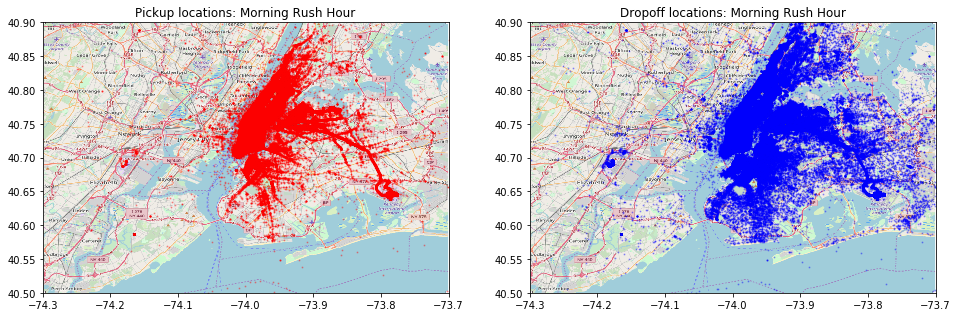

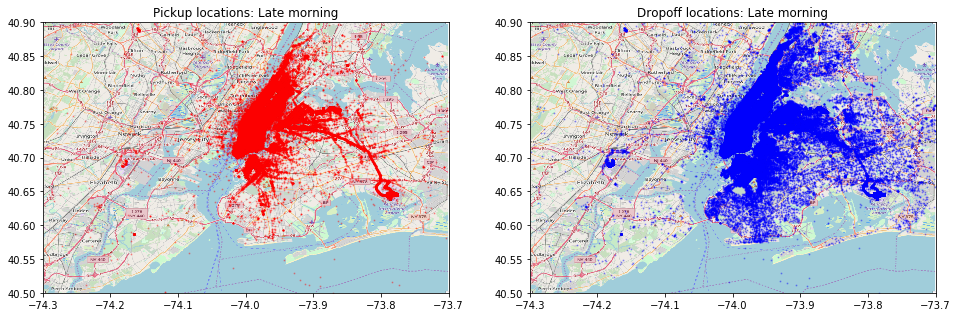

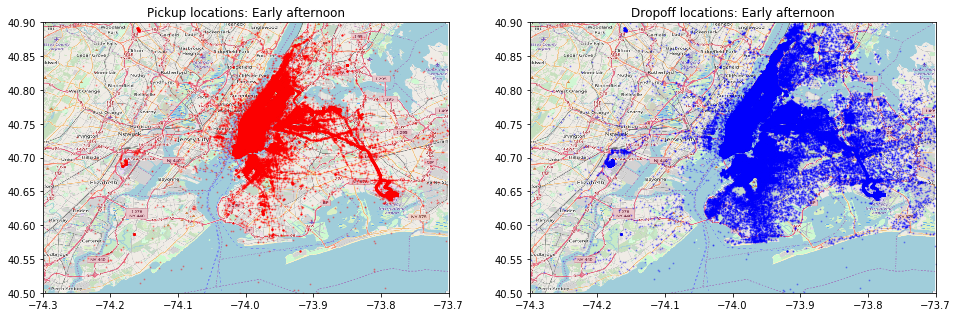

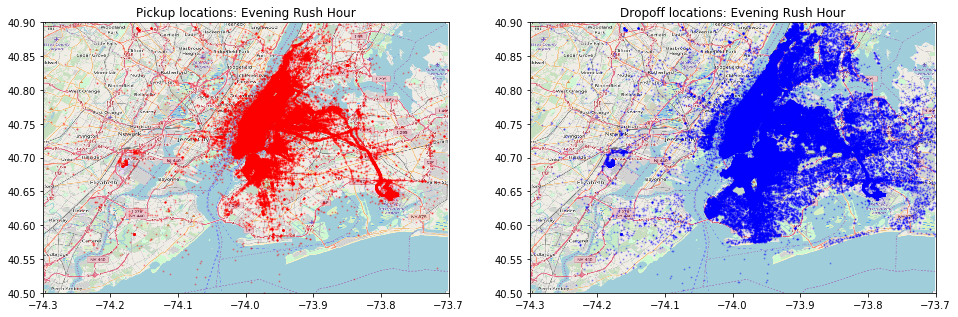

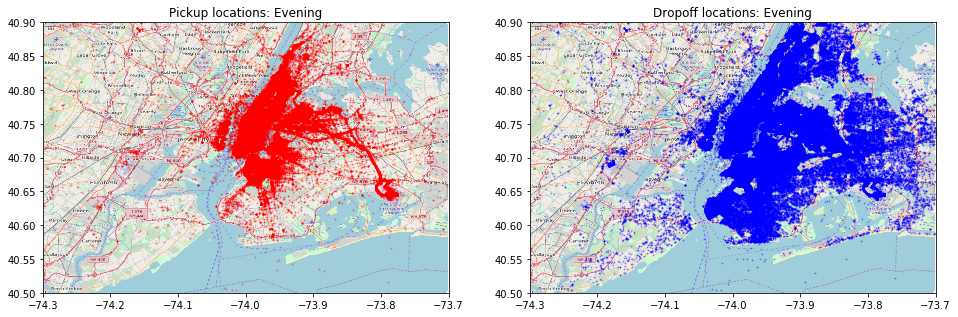

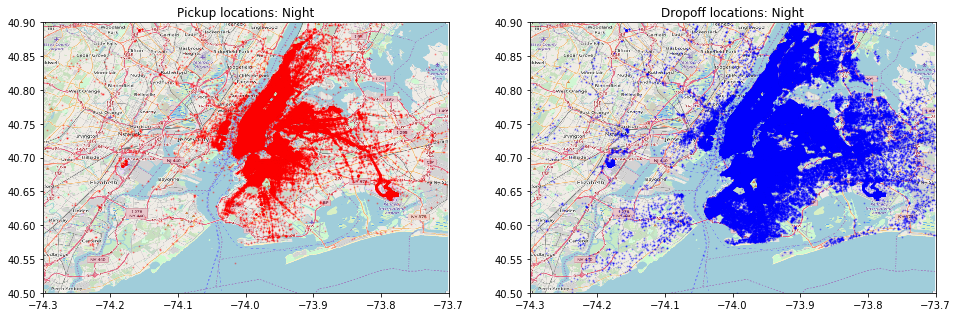

In [148]:
# plot training data on map zoomed in
dayPeriods = [
    'Morning Rush Hour', 'Late morning', 'Early afternoon',
    'Evening Rush Hour', 'Evening', 'Night'
]
for period in dayPeriods:
    print(period)
    plot_on_map(tripDataFare[tripDataFare['pickup_timeOfDay'] == period],
                BB_zoom,
                nyc_map_zoom,
                s=1,
                alpha=0.3,
                title=period)
    print("Completed " + period)

In [163]:
tripDataFare[tripDataFare['pickup_timeOfDay'] == 'Morning Rush Hour'].pickup_hour.unique()

array([8, 6, 7, 9])

4
Completed 4
5
Completed 5
6
Completed 6
7
Completed 7
8
Completed 8
9
Completed 9
10
Completed 10
11
Completed 11
12
Completed 12
13
Completed 13
14
Completed 14
15
Completed 15
16
Completed 16
17
Completed 17
18
Completed 18
19
Completed 19
20
Completed 20
21
Completed 21
22
Completed 22
23
Completed 23
0


/opt/conda/envs/working/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


Completed 0
1
Completed 1
2
Completed 2
3
Completed 3


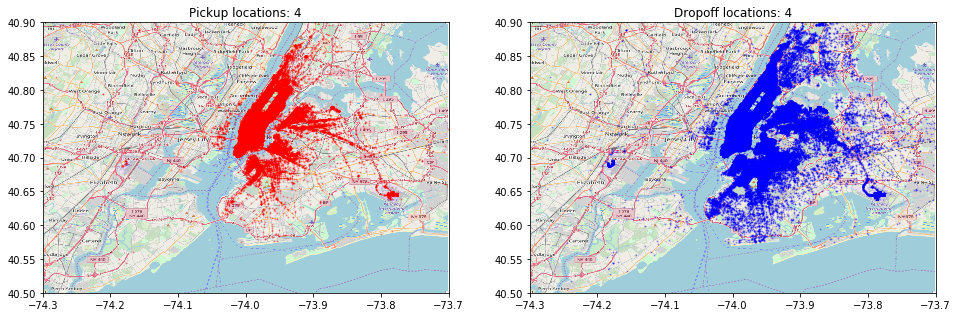

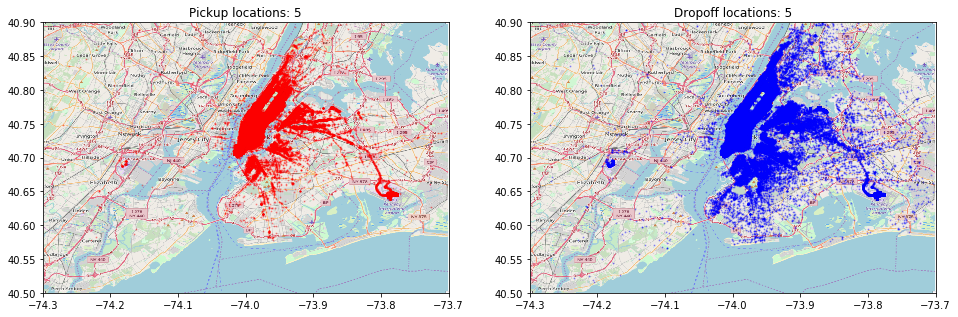

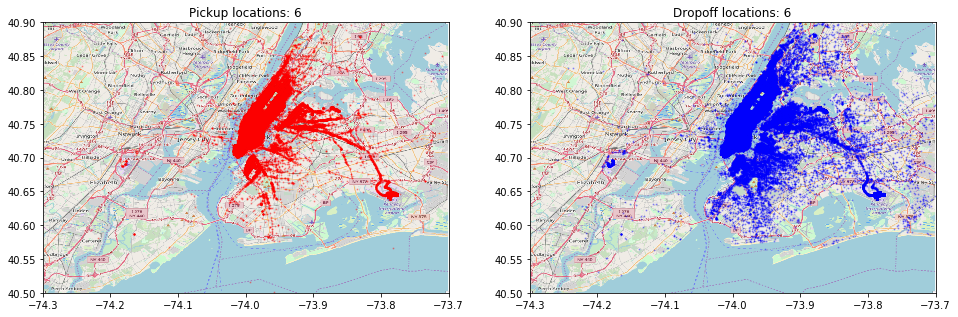

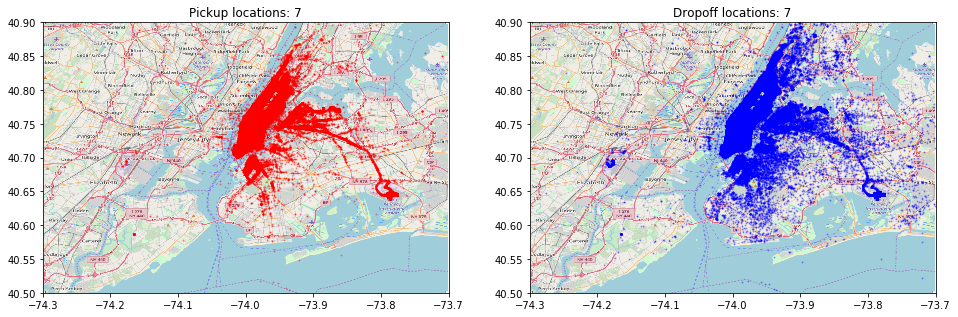

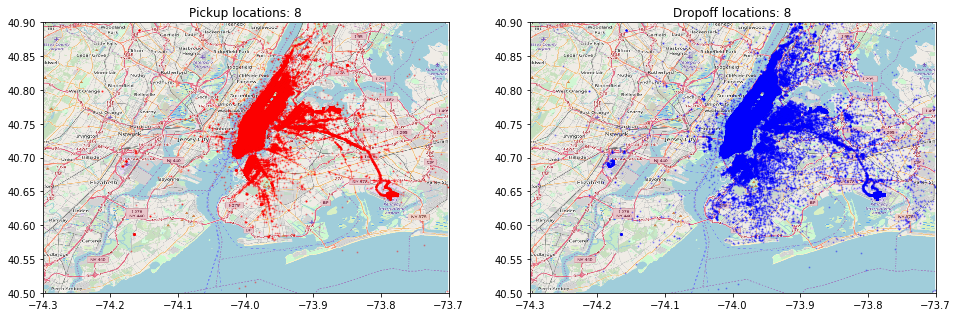

...

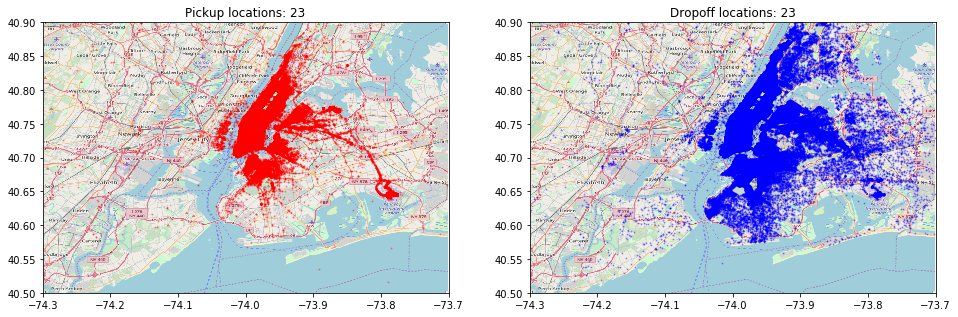

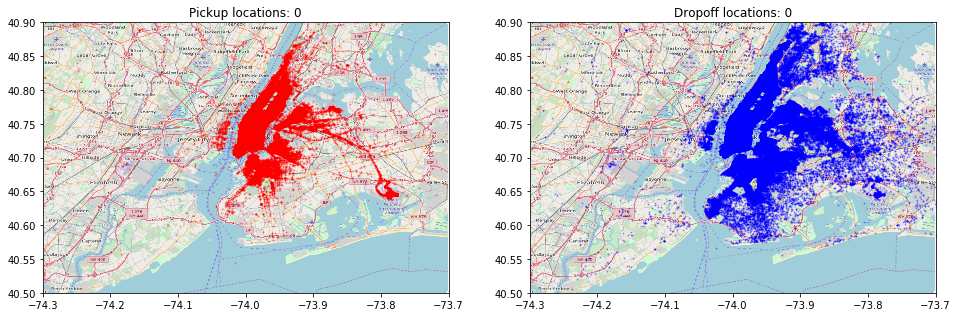

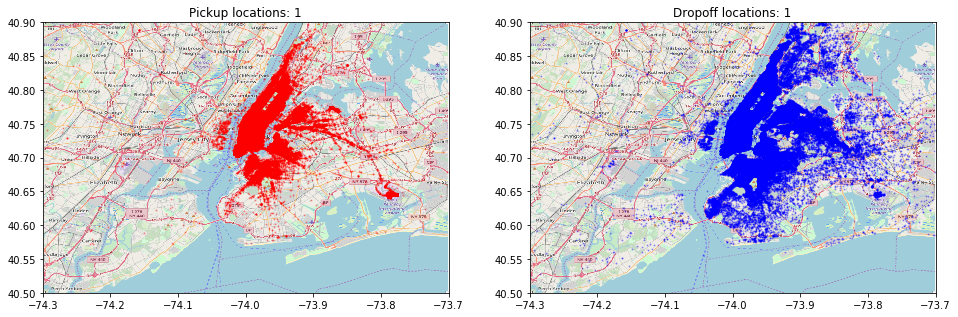

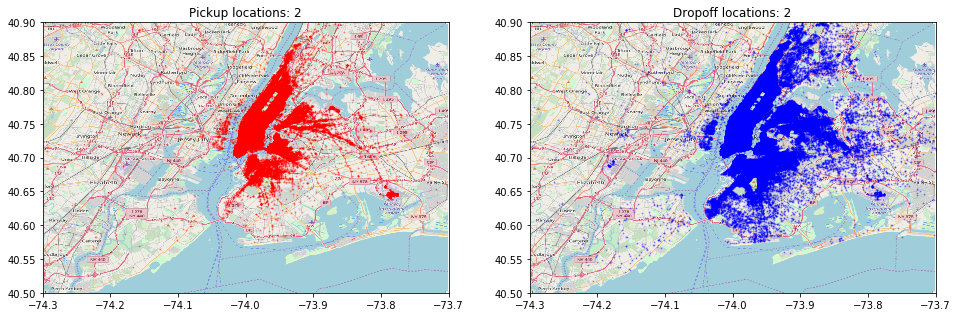

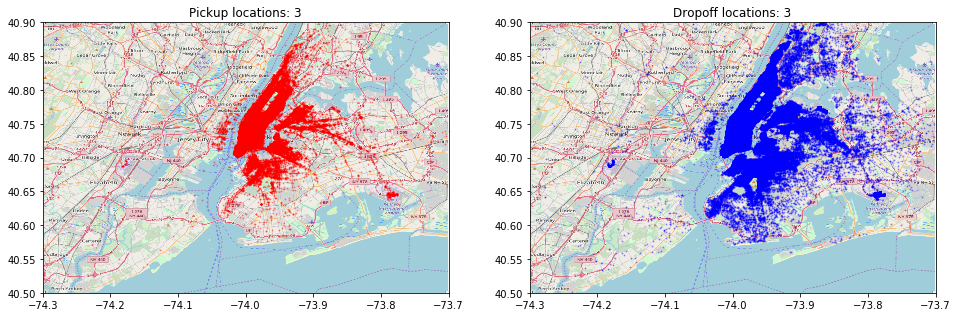

In [169]:
# plot training data on map zoomed in
timePeriods = [4, 5, 6, 7, 8, 9, 10, 11,12,13,14,15,16,17,18,19,20,21,22,23,0,1,2,3   
]

for period in timePeriods:
    print(period)
    plot_on_map(tripDataFare[tripDataFare['pickup_hour'] == period],
                BB_zoom,
                nyc_map_zoom,
                s=1,
                alpha=0.3,
                title=str(period))
    print("Completed " + str(period))

In [174]:
tripDataFare[tripDataFare['pickup_timeOfDay'] == 'Morning Rush Hour'].pickup_hour.unique()


array([8, 6, 7, 9])

In [175]:

tripDataFare.pickup_weekdayWeekend.unique()

array(['Weekday', 'Weekend'], dtype=object)

Weekday
Completed Weekday
Weekend
Completed Weekend


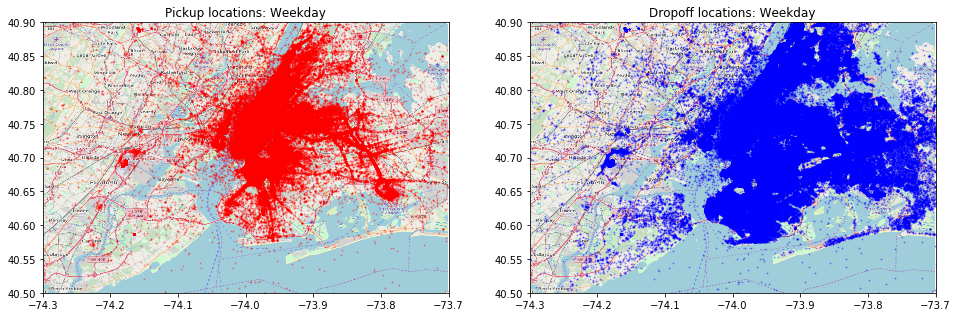

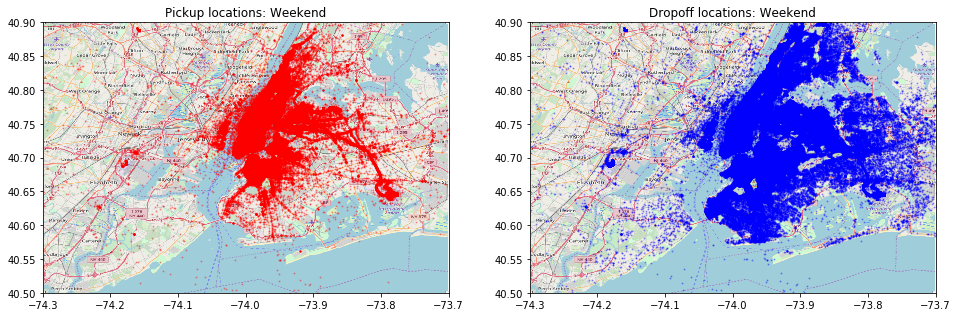

In [184]:
# plot training data on map zoomed in
timePeriods = ['Weekday', 'Weekend'  
]

for period in timePeriods:
    print(period)
    plot_on_map(tripDataFare[tripDataFare['pickup_weekdayWeekend'] == period],
                BB_zoom,
                nyc_map_zoom,
                s=1,
                alpha=0.3,
                title=str(period))
    print("Completed " + str(period))

# Plotting raw lat longs

In [176]:
# this function will also be used with the test set below
def select_within_boundingbox(df, BB):
    return (df.pickup_longitude >= BB[0]) & (df.pickup_longitude <= BB[1]) & \
           (df.pickup_latitude >= BB[2]) & (df.pickup_latitude <= BB[3]) & \
           (df.dropoff_longitude >= BB[0]) & (df.dropoff_longitude <= BB[1]) & \
           (df.dropoff_latitude >= BB[2]) & (df.dropoff_latitude <= BB[3])

In [177]:
def plot_hires(df, BB, figsize=(12, 12), ax=None, c=('r', 'b')):
    if ax == None:
        fig, ax = plt.subplots(1, 1, figsize=figsize)

    idx = select_within_boundingbox(df, BB)
    ax.scatter(df[idx].pickup_longitude, df[idx].pickup_latitude, c=c[0], s=0.01, alpha=0.5)
    ax.scatter(df[idx].dropoff_longitude, df[idx].dropoff_latitude, c=c[1], s=0.01, alpha=0.5)

In [178]:
drivers = ['00B7691D86D96AEBD21DD9E138F90840','C1059E614E05082428C20540004D03CE', 'AF21D0C97DB2E27E13572CBF59EB343D', 'C667D53ACD899A97A85DE0C201BA99BE', 'B59C67BF196A4758191E42F76670CEBA']

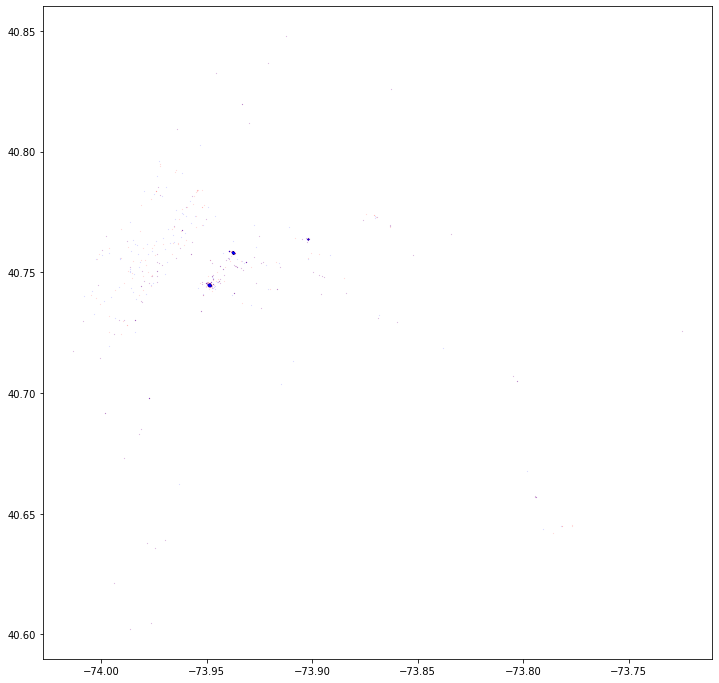

In [181]:
plot_hires(tripDataFare[tripDataFare['hack_license'].isin(drivers)], (-74.1, -73.7, 40.6, 40.9))


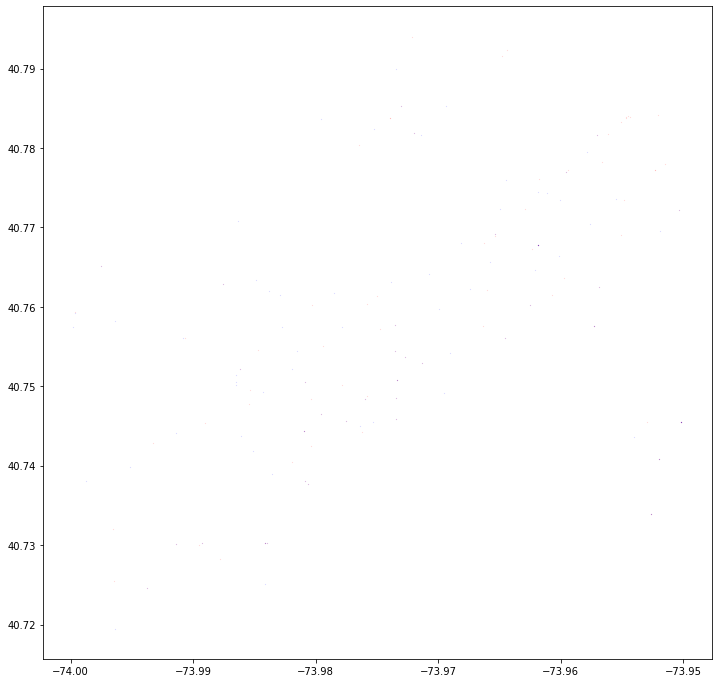

In [183]:
plot_hires(tripDataFare[tripDataFare['hack_license'].isin(drivers)], (-74, -73.95, 40.7, 40.8))

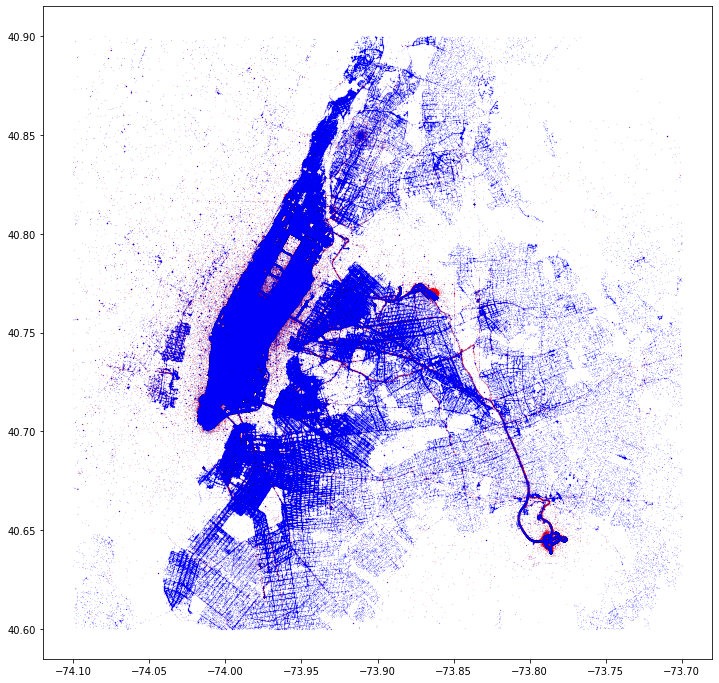

In [186]:
plot_hires(tripDataFare, (-74.1, -73.7, 40.6, 40.9))

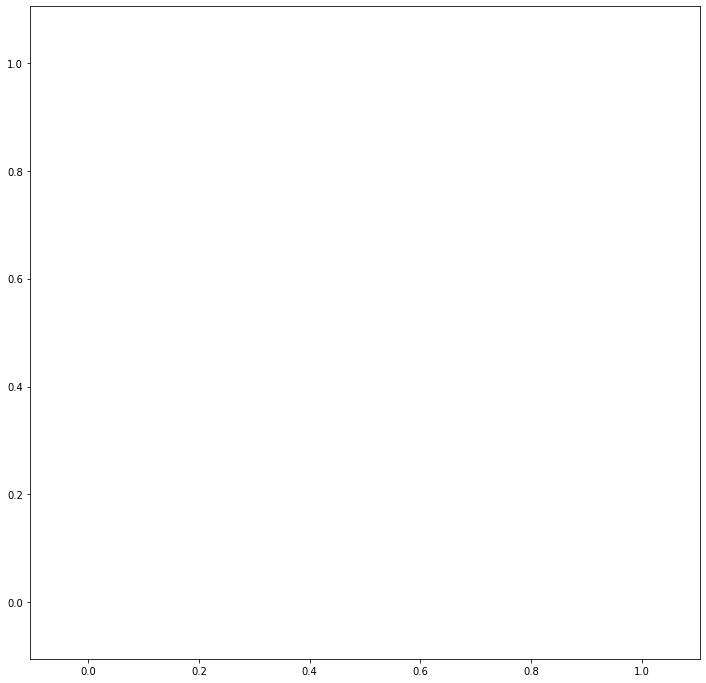

In [194]:
plot_hires(tripDataFare, (-73.9, -73.9, 40.7, 40.7))

In [196]:
plot_hires(tripDataFare, (-74, -73.95, 40.7, 40.8))

Error in callback <function flush_figures at 0x7fe3e40b6488> (for post_execute):


KeyboardInterrupt: 

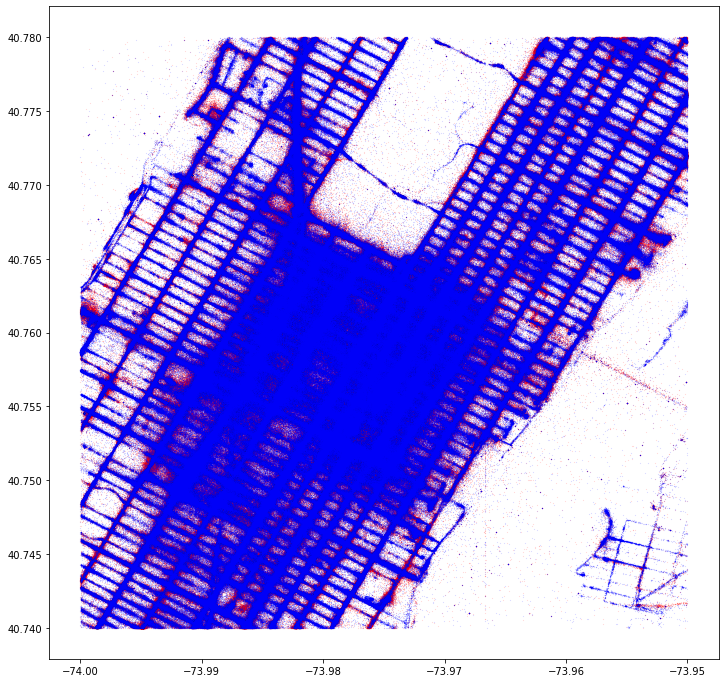

In [197]:
plot_hires(tripDataFare, (-74, -73.95, 40.74, 40.78))

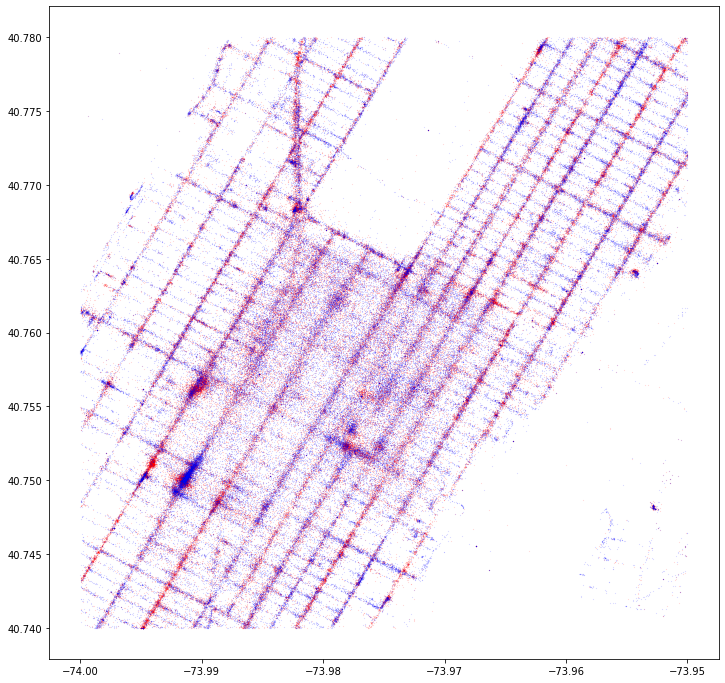

In [203]:
plot_hires(tripDataFare[tripDataFare['Taxi Use']=='Extreme'], (-74, -73.95, 40.74, 40.78))


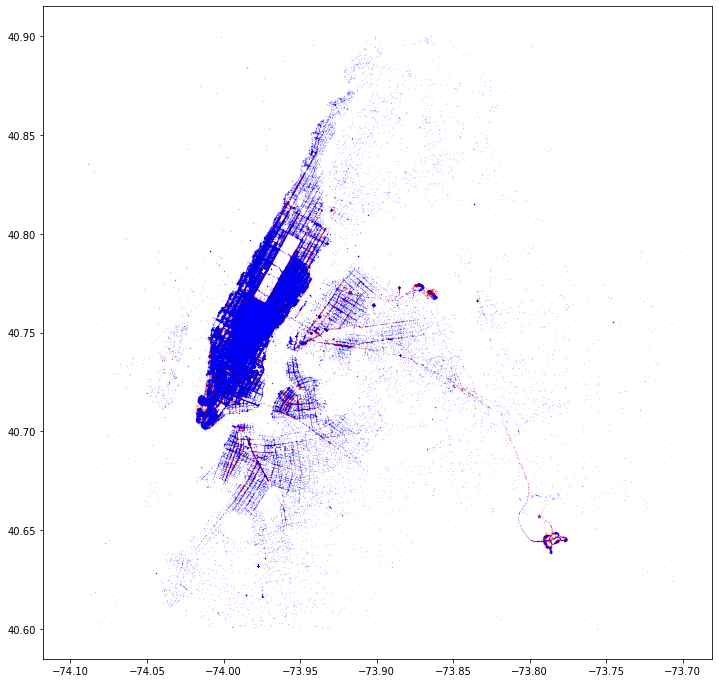

In [204]:
plot_hires(tripDataFare[tripDataFare['Taxi Use']=='Extreme'], (-74.1, -73.7, 40.6, 40.9))

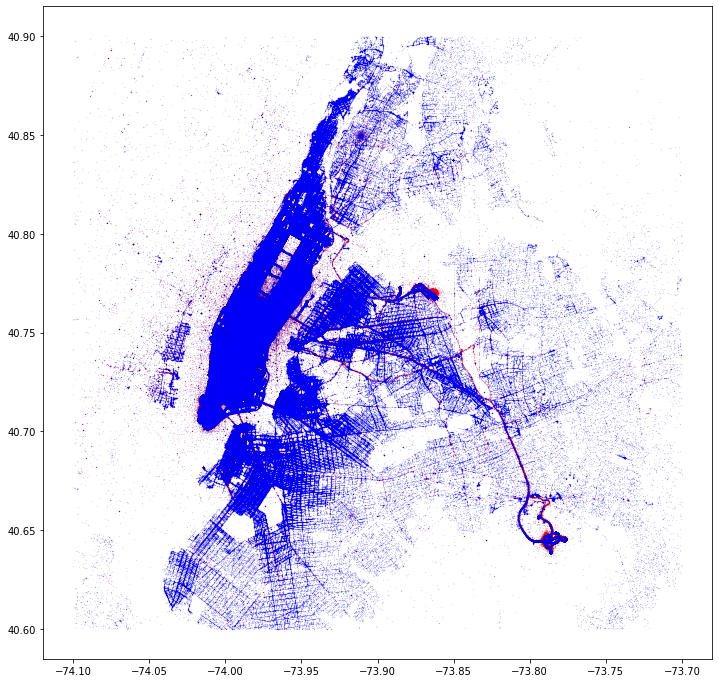

In [206]:
plot_hires(tripDataFare[tripDataFare['Taxi Use']=='Single Use'], (-74.1, -73.7, 40.6, 40.9))

In [200]:
tripDataFare['Taxi Use'].unique()

array(['High', 'Single Use', 'Low', 'Extreme', 'Medium'], dtype=object)

In [209]:
tripDataFare[tripDataFare['Taxi Use']=='Single Use'].shape

(9649575, 52)

In [210]:
tripDataFare[tripDataFare['Taxi Use']=='Extreme'].shape

(376376, 52)